<a href="https://colab.research.google.com/github/Alenush/dish_id_sirius/blob/Team-1/chefnet_LSTM_finetune.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Загрузка данных

In [3]:
!pip install gdown

### Загрузка картинок

In [4]:
!gdown https://drive.google.com/uc?id=1Usn-XgKql3aUAQcbt5S4-BEM7Zg8Jgwq
!unzip -qq AllRecipes_images.zip
!rm AllRecipes_images.zip

Downloading...
From: https://drive.google.com/uc?id=1-0KR4plqclq1M67fVe0Ja6Mi260SmLbH
To: /content/AllRecipes_images.zip
4.02GB [01:06, 60.6MB/s]


In [38]:
import os
print(f"Train amount - {len(os.listdir('AllRecipes_images/train'))}")
print(f"Val amount - {len(os.listdir('AllRecipes_images/val'))}")

Train amount - 162547
Val amount - 40648


### Загрузка ингредиентов блюд

In [8]:
!gdown https://drive.google.com/uc?id=1vc2OT7zAGlcbMi25Or2JUWLevES238aS
!gdown https://drive.google.com/uc?id=1j8TwUnEqK57uwi2JXvbCxmIucewK27LJ

Downloading...
From: https://drive.google.com/uc?id=1vc2OT7zAGlcbMi25Or2JUWLevES238aS
To: /content/recipes_raw.json
12.0MB [00:00, 28.9MB/s]
Downloading...
From: https://drive.google.com/uc?id=1j8TwUnEqK57uwi2JXvbCxmIucewK27LJ
To: /content/clean_ingred.txt
100% 1.78k/1.78k [00:00<00:00, 2.91MB/s]


## Проверка данных

Проверка на битые картинки

In [ ]:
def check_bad_img(path_to_img, img_size):
  bad_imgs_count = 0
  for file_name in tqdm(os.listdir(path_to_img), desc='Checking images'):
    img = Image.open(path_to_img + file_name).convert('RGB')
    if img.size != img_size:
      print(f'Image {file_name} size - {img.size}')
      bad_imgs_count += 1
  print(f'Total bad images found = {bad_imgs_count}')

path_to_img = 'AllRecipes_images/'
check_bad_img(path_to_img, (250, 250))


Total bad images found = 0


## Exploratory data analysis

In [18]:
from collections import Counter
import numpy as np
import matplotlib.pyplot as plt
from collections import defaultdict
from tqdm.notebook import tqdm
import json

In [19]:
recipe_list = []
with open('recipes_raw.json', 'r') as f:
  recipe_list = json.load(f)

In [20]:
len_ingred_count = Counter()

for recipe in recipe_list:
  len_ingred_count[len(recipe['ingred_list'])] += 1

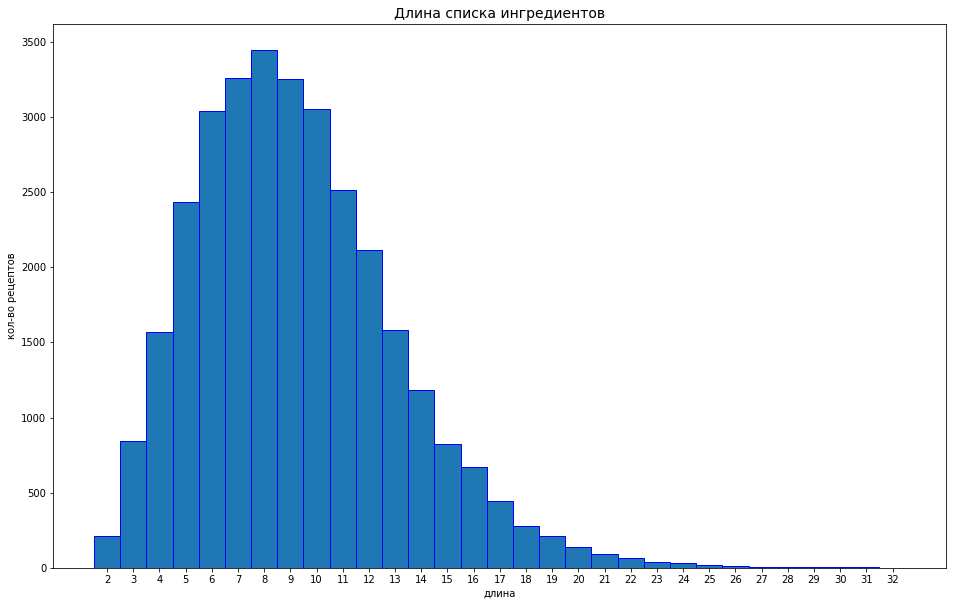

In [21]:
labels, values = zip(*len_ingred_count.items())
indexes = np.arange(min(labels), max(labels) + 1)

plt.figure(figsize=(16, 10))
plt.title('Длина списка ингредиентов', fontsize=14)
width = 1
plt.bar(labels, values, width, edgecolor='b')
plt.xticks(indexes)
plt.xlabel('длина')
plt.ylabel('кол-во рецептов')
plt.show()

In [22]:
imgs_list = set(os.listdir('AllRecipes_images'))

img_on_recipe = defaultdict(list)

for recipe in tqdm(recipe_list):
  recipe_id = recipe['id']
  i = 0
  while True:
    img = f'{recipe_id}_{i}.jpg'
    if img in imgs_list:
      i += 1
    else:
      img_on_recipe[i].append(recipe_id)
      break

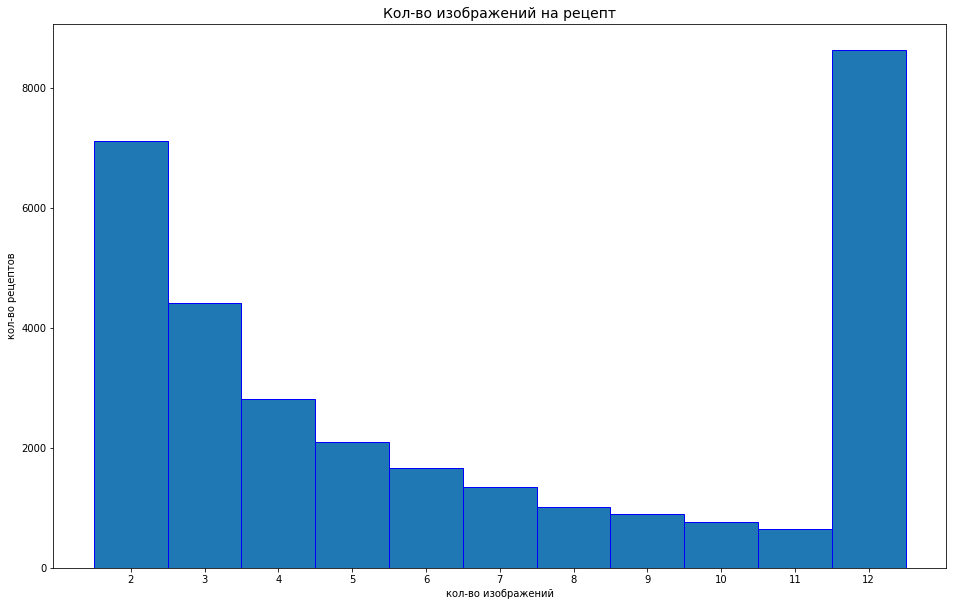

In [23]:
labels = list(img_on_recipe.keys())
values = [len(l) for l in img_on_recipe.values()]
indexes = np.arange(min(labels), max(labels) + 1)

plt.figure(figsize=(16, 10))
plt.title('Кол-во изображений на рецепт', fontsize=14)
width = 1
plt.bar(labels, values, width, edgecolor='b')
plt.xticks(indexes)
plt.xlabel('кол-во изображений')
plt.ylabel('кол-во рецептов')
plt.show()

## Preprocessing

In [57]:
from PIL import Image
from tqdm.notebook import tqdm
import os
import json

Препроцессинг ингредиентов

In [40]:
with open('recipes_raw.json', 'rb') as f:
  recipe_list = json.loads(f.read())

In [41]:
import html
from html.parser import HTMLParser
import re
import unicodedata

REPLACEMENTS = {
    u'\x91':"'", u'\x92':"'", u'\x93':'"', u'\x94':'"', u'\xa9':'',
    u'\xba': ' degrees ', u'\xbc':' 1/4', u'\xbd':' 1/2', u'\xbe':' 3/4',
    u'\xd7':'x', u'\xae': '',
    '\\u00bd':' 1/2', '\\u00bc':' 1/4', '\\u00be':' 3/4',
    u'\\u2153':' 1/3', '\\u00bd':' 1/2', '\\u00bc':' 1/4', '\\u00be':' 3/4',
    '\\u2154':' 2/3', '\\u215b':' 1/8', '\\u215c':' 3/8', '\\u215d':' 5/8',
    '\\u215e':' 7/8', '\\u2155':' 1/5', '\\u2156':' 2/5', '\\u2157':' 3/5',
    '\\u2158':' 4/5', '\\u2159':' 1/6', '\\u215a':' 5/6', '\\u2014':'-',
    '\\u0131':'1', '\\u2122':'', '\\u2019':"'", '\\u2013':'-', '\\u2044':'/',
    '\\u201c':'\\"', '\\u2018':"'", '\\u201d':'\\"', '\\u2033': '\\"',
    '\\u2026': '...', '\\u2022': '', '\\u2028': ' ', '\\u02da': ' degrees ',
    '\\uf04a': '', u'\xb0': ' degrees ', '\\u0301': '', '\\u2070': ' degrees ',
    '\\u0302': '', '\\uf0b0': ''
}

parser = HTMLParser()
def prepro_txt(text):
    import urllib

    text = html.unescape(text)

    for unichar, replacement in REPLACEMENTS.items():
      if unichar in text:
        text = text.replace(unichar, replacement)
    text = unicodedata.normalize('NFKD', text).encode('ascii', 'ignore')

    try:
        text = urllib.parse.unquote(text.decode('ascii'))
    except UnicodeDecodeError:
        pass # if there's an errant %, unquoting will yield an invalid char

    # some extra tokenization
    text = ' - '.join(text.split('-'))
    text = ' & '.join(text.split('&'))

    text = re.sub(r'\\[nt]', ' ', text) # remove over-escaped line breaks and tabs
    text = re.sub(r'\b([^\d\s]+)/(.*)\b', r'\1 / \2', text) # split non-fractions
    text = re.sub(r'\b(.*)/([^\d\s]+)\b', r'\1 / \2', text) # e.g. 350 deg/gas mark
    text = re.sub(r'\s+', ' ', text) # remove extra whitespace

    return text.strip()

In [42]:
for recipe in tqdm(recipe_list, desc='Preprocess ingredients'):
  ingred_list = recipe['ingred_list']
  new_ingred_list = []
  for ingred in ingred_list:
    new_ingred_list.append(prepro_txt(ingred))
  recipe['ingred_list'] = new_ingred_list

In [43]:
from string import ascii_lowercase
def replace_units(s):
  tokens = s.replace('to taste', '').split()
  units = ['ounce', 'ounces', 'cups', 'cup', 'teaspoon', 'tablespoon', 'tablespoons', 'teaspoons', 
           'c', 'g', 'v', 'tbsp', 'x', 'ml', 'lb', 'tbs', 'oz', 'pkg', 'large', 'small', 'tsp', 'inch', 
           'grams', 'quarts', 'lbs', 'can', 'cube', 'whole', 'or', 'pieces', 'piece', 'chopped', 
           'shredded', 'diced', 'fresh', 'crushed', 'minced']
  tokens_new = []
  for t in tokens:
      if t not in units:
          tokens_new.append(t)
  
  return ' '.join(tokens_new)

def cleanup_ingredient_list(l):
    l = [replace_units(''.join([char for char in x.lower() if char in ascii_lowercase + ' ']).strip()) for x in l]
    return l

In [44]:
for recipe in tqdm(recipe_list, desc='Preprocess ingredients'):
  recipe['ingred_list'] = cleanup_ingredient_list(recipe['ingred_list'])

In [45]:
import csv
import re
from collections import Counter
from itertools import permutations as permut

clean_ingredients - эталонный список ингредиентов

In [ ]:
# clean_ingredients = set()

# with open('nndb_flat.csv', 'r') as f:
#   reader = csv.reader(f)
#   next(reader)
#   for row in tqdm(reader):
#     row = row[3].lower()
#     row = re.sub(r'\([^)]*\)', '', row)
#     row = re.split(r',\s', row)
#     row = [item.strip() for item in row]
#     trigrams = []
#     for bigram in permut(row[:0:-1], 2):
#       trigram = re.sub(r',', '', ' '.join([*bigram, row[0]])).strip()
#       trigrams.append(trigram)
#     bigrams = []
#     for unigram in row[:0:-1]:
#       bigram = re.sub(r',', '', ' '.join([unigram, row[0]])).strip()
#       bigrams.append(bigram)
#     candidates = [*trigrams, *bigrams, row[0]]

#     clean_ingredients.update(candidates)

# clean_ingredients = list(clean_ingredients)

In [46]:
with open('clean_ingred.txt', 'r') as f:
  clean_ingredients = set(f.read().split('\n'))
print(len(clean_ingredients))

226


In [47]:
import inflect
engine = inflect.engine()


def get_another_form(word):
  def is_singular(word):
    return engine.singular_noun(word) == False
  if is_singular(word):
    return engine.plural_noun(word)
  else:
    return engine.singular_noun(word)


SYNONIMS_DICT = {'whipping cream' : 'whipped cream',
                 'rolled oats' : 'cereals',
                 'berry jell' : 'jell',
                 'strawberry jell' : 'jell',
                 'lime jell' : 'jell',
                 'vanilla jell' : 'jell',
                 'cherry jell' : 'jell',
                 'raspberry jell' : 'jell',
                 'orange jell' : 'jell',
                 'watemelon jell' : 'jell',
                 'lima beans' : 'beans',
                 'kidney beans' : 'beans',
                 'pinto beans' : 'beans',
                 'serrano pepper' : 'chili pepper',
                 'light cream' : 'cream cheese',
                 'cheese spread' : 'cream cheese',
                 'caraway seeds' : 'cumin seeds',
                 'marmalade' : 'jam',
                 'jellybeans' : 'candy',
                 'hot dog' : 'sausage',
                 'pepperoni' : 'sausage',
                 'pastry' : 'dough',
                 'vermout' : 'alcohol',
                 'vodka' : 'alcohol',
                 'liqueur' : 'alcohol',
                 'liquor' : 'alcohol',
                 'vermouth' : 'alcohol',
                 'whiskey' : 'alcohol',
                 }


def clean_ingredient_list(ingr_list, clean_ingredients):
    recipe = []
    for ingr in ingr_list:
      ingr = ingr.split()
      ingr_found = False
      for trigram in permut(ingr, 3):
        trigram = ' '.join(trigram)
        another_form = get_another_form(trigram)
        if trigram in SYNONIMS_DICT:
          trigram = SYNONIMS_DICT[trigram]
        if another_form in SYNONIMS_DICT:
          trigram = SYNONIMS_DICT[another_form]
        if trigram in clean_ingredients:
          recipe.append(trigram)
          ingr_found = True
          break
        if another_form in clean_ingredients:
          recipe.append(another_form)
          ingr_found = True
          break
      if ingr_found:
        continue
      for bigram in permut(ingr, 2):
        bigram = ' '.join(bigram)
        another_form = get_another_form(bigram)
        if bigram in SYNONIMS_DICT:
          bigram = SYNONIMS_DICT[bigram]
        if another_form in SYNONIMS_DICT:
          bigram = SYNONIMS_DICT[another_form]
        if bigram in clean_ingredients:
          recipe.append(bigram)
          ingr_found = True
          break
        if another_form in clean_ingredients:
          recipe.append(another_form)
          ingr_found = True
          break
      if ingr_found:
        continue
      for unigram in ingr:
        if unigram in SYNONIMS_DICT:
          unigram = SYNONIMS_DICT[unigram]
        another_form = get_another_form(unigram)
        if another_form in SYNONIMS_DICT:
          unigram = SYNONIMS_DICT[another_form]
        if unigram in clean_ingredients:
          recipe.append(unigram)
          break
        if another_form in clean_ingredients:
          recipe.append(another_form)
          break

    return list(set(recipe))

In [139]:
for recipe in tqdm(recipe_list):
  recipe['ingred_list'] = clean_ingredient_list(recipe['ingred_list'], clean_ingredients)

In [ ]:
empty_recipes = []
for recipe in recipe_list:
  if len(recipe['ingred_list']) == 0:
    print(recipe)
    empty_recipes.append(recipe['id'])
print(f'Рецептов с пустым списком ингред-ов - {len(empty_recipes)}')

In [ ]:
empty_recipes = [recipe['id'] for recipe in empty_recipes]

Удалим их

In [154]:
recipe_list = [recipe for recipe in recipe_list if len(recipe['ingred_list']) > 0]

with open('recipes.json', 'w') as f:
  f.write(json.dumps(recipe_list, indent=2))

In [51]:
for img in os.listdir('AllRecipes_images/train'):
  img_name = img.split('_')[0]
  if img_name in empty_recipes:
    os.remove(os.path.join('AllRecipes_images/train', img))

for img in os.listdir('AllRecipes_images/val'):
  img_name = img.split('_')[0]
  if img_name in empty_recipes:
    os.remove(os.path.join('AllRecipes_images/val', img))

In [52]:
import os
print(f"Train amount - {len(os.listdir('AllRecipes_images/train'))}")
print(f"Val amount - {len(os.listdir('AllRecipes_images/val'))}")

Train amount - 162547
Val amount - 40648


Посмотрим, сколько уникальных инг-ов в датасете

In [53]:
all_ingred = []

for recipe in tqdm(recipe_list):
    all_ingred.extend(recipe['ingred_list'])

print(f'Found {len(set(all_ingred))} unique ingredients in dataset of all recipes') 


Found 221 unique ingredients in dataset of all recipes


In [54]:
from collections import Counter
c = Counter(all_ingred)
print('Most popular ingredients:')
c.most_common(20)

Most popular ingredients:


[('salt', 14710),
 ('sugar', 11442),
 ('onion', 10260),
 ('butter', 9701),
 ('egg', 9097),
 ('flour', 8262),
 ('black pepper', 7606),
 ('water', 6555),
 ('olive', 5951),
 ('milk', 5609),
 ('chicken', 5118),
 ('vanilla', 4705),
 ('cloves garlic', 4236),
 ('vegetables', 4186),
 ('tomato', 3884),
 ('lemon', 3530),
 ('cinnamon', 3117),
 ('cheese', 3018),
 ('pepper', 2903),
 ('baking powder', 2723)]

## Обучение

In [55]:
import os
import json
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms, models
from torch.utils.data import Dataset, DataLoader
from torch.nn.utils.rnn import pack_padded_sequence, pad_sequence
from collections import defaultdict
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np
from tqdm.notebook import tqdm
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
print(device)

cuda


In [56]:
with open('recipes.json', 'rb') as f:
  recipe_list = json.loads(f.read())
with open('clean_ingred.txt', 'r') as f:
  clean_ingredients = set(f.read().split('\n'))

In [57]:
id2word = defaultdict()
id2word[0] = '<pad>'
id2word[1] = '<start>'
id2word[2] = '<end>'
for i, ingr in enumerate(clean_ingredients):
  id2word[i+3] = ingr

word2id = {v:k for k,v in id2word.items()}

In [58]:
def ids2words(word_ids):
  result = []
  for id in word_ids:
    word = id2word[id]
    if word == '<start>':
      continue
    elif word == '<end>':
      break
    else:
      result.append(word)
  return result

def words2ids(words):
  return [word2id[word] for word in words]

In [59]:
class RecipesDataset(Dataset):
  def __init__(self, recipes_json, img_folder, transform=None):
    super().__init__()

    with open(recipes_json, 'r') as f:
      recipes = json.load(f)
    self.recipes = defaultdict(dict)
    for recipe in recipes:
      recipe['ingred_list'].insert(0, '<start>')
      recipe['ingred_list'].append('<end>')
      self.recipes[recipe['id']] = recipe

    self.img_folder = img_folder
    self.imgs = os.listdir(self.img_folder)
    self.imgs = [img for img in self.imgs if img.split('_')[0] in self.recipes]
    
    self.transform = transform

  def __getitem__(self, index):
    img_name = self.imgs[index]
    img = Image.open(self.img_folder + img_name).convert('RGB')
    if self.transform is not None:
      img = self.transform(img)
    
    recipe_id = img_name.split('_')[0]
    ingred_list = self.recipes[recipe_id]['ingred_list']
    return img, torch.LongTensor(words2ids(ingred_list))

  def __len__(self):
    return len(self.imgs)

In [60]:
from torch.nn.utils.rnn import pad_sequence

def pad_collate(data):
  # отсортируем по длине описания
  data.sort(key=lambda x: len(x[1]), reverse=True)
  images, captions = zip(*data)
  
  # составим 4D тензор изображений из кортежа 3D тензоров
  # images: (batch_size, channels(rgb), width, height)
  images = torch.stack(images, 0)

  # составим 2D тензор описаний из кортежа 1D тензоров
  # дополним каждое описание символом <pad> так, чтобы у всех описаний совпадали длины
  lengths = [len(cap) for cap in captions]
  targets = torch.LongTensor(np.zeros((len(captions), max(lengths))))
  for i, cap in enumerate(captions):
    end = lengths[i]
    targets[i, :end] = cap[:end]  

  return images, targets, lengths

In [183]:
class Encoder(nn.Module):
  def __init__(self, encoder, embed_size, dropout=0.5, finetune=False):
    super().__init__()
    
    self.finetune = finetune
    if not self.finetune:
      for param in encoder.parameters():
        param.requires_grad = False

    modules = list(encoder.children())[:-1]
    self.resnet = nn.Sequential(*modules)

    # self.linear = nn.Sequential(nn.Conv2d(encoder.fc.in_features, embed_size, kernel_size=1, padding=0),
    #                                 nn.Dropout2d(dropout))
    self.linear = nn.Linear(2048, embed_size)
  
  def finetune_active(self, activate, num_layers):
    for layer in list(self.resnet.children()):
      for param in layer.parameters():
        param.requires_grad = False
    if activate:
      self.finetune = True
      for layer in list(self.resnet.children())[-num_layers:]:
        for param in layer.parameters():
          param.requires_grad = True
    else:
      self.finetune = False
      for layer in list(self.resnet.children())[-num_layers:]:
        for param in layer.parameters():
          param.requires_grad = False
  
  def forward(self, images):
    if not self.finetune:  
      with torch.no_grad():
        features = self.resnet(images)
    else:
        features = self.resnet(images)
    features = features.view(features.size(0), -1)
    features = self.linear(features)
    return features

In [62]:
class Decoder(nn.Module):
    def __init__(self, encod_size, embed_size, hidden_size, vocab_size, num_layers=2, dropout=0):
      super().__init__()
      self.embedding = nn.Embedding(vocab_size, embed_size)
      self.rnn = nn.LSTM(embed_size, hidden_size, num_layers, batch_first=True,
                         dropout=dropout)
      self.linear = nn.Linear(hidden_size, vocab_size)
  
    # обучение, используются истинные описания
    def forward(self, features, captions, lengths):
      embed = self.embedding(captions)
      embed = torch.cat((features.unsqueeze(1), embed), 1)
      packed = pack_padded_sequence(embed, lengths, batch_first=True)
      outputs, _ = self.rnn(packed)
      outputs = self.linear(outputs[0])
      return outputs

    # проверка, истинные описания не используются
    def sample(self, features, max_len, states=None):
      id_preds = list()
      inputs = features.unsqueeze(1)
      for i in range(max_len):
        rnn_outputs, states = self.rnn(inputs, states)
        lin_outputs = self.linear(rnn_outputs.squeeze(1))
        _, pred_id = lin_outputs.max(1)
        id_preds.append(pred_id)
        inputs = self.embedding(pred_id).unsqueeze(1)
      id_preds = torch.stack(id_preds, 1)
      return id_preds

In [223]:
!pip install googletrans

     |████████████████████████████████| 61kB 4.7MB/s 
     |████████████████████████████████| 51kB 7.2MB/s 
     |████████████████████████████████| 921kB 43.3MB/s 
     |████████████████████████████████| 61kB 9.4MB/s 
     |████████████████████████████████| 71kB 10.3MB/s 
     |████████████████████████████████| 102kB 13.0MB/s 
  Created wheel for googletrans: filename=googletrans-3.0.0-cp36-none-any.whl size=15736 sha256=619fb78bfac6e2b5aeeeacac68d5bd48a8a3124b33c091b505a1278f540dfa7c
  Stored in directory: /root/.cache/pip/wheels/28/1a/a7/eaf4d7a3417a0c65796c547cff4deb6d79c7d14c2abd29273e
  Created wheel for contextvars: filename=contextvars-2.4-cp36-none-any.whl size=7666 sha256=2fffc0503d1458c221f602630bb3db316b828e9e5605b3d50b025444c43c0ff3
  Stored in directory: /root/.cache/pip/wheels/a5/7d/68/1ebae2668bda2228686e3c1cf16f2c2384cea6e9334ad5f6de
Successfully built googletrans contextvars


In [248]:
from random import randint
from googletrans import Translator
translator = Translator()

val_images = os.listdir('AllRecipes_images/val')

transform_val = transforms.Compose([
  transforms.CenterCrop((224, 224)),
  transforms.ToTensor(),
  transforms.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225))
])

def predict_val_image():
  with torch.no_grad():
    img_name = val_images[randint(0, len(val_images)-1)]
    recipe_id = img_name.split('_')[0]
    img = Image.open(os.path.join('AllRecipes_images/val', img_name))
    plt.figure(figsize=(12,8))
    plt.imshow(img)
    plt.axis('off')
    plt.show()
    img = transform_val(img).to(device).unsqueeze(0)
    ingred_pred = ids2words(decoder.sample(encoder(img), 30)[0].cpu().numpy())
    ingred_pred = [en2ru[ing] for ing in ingred_pred]
    
    dish_name = train_data.recipes[recipe_id]['item_name']
    dish_name = translator.translate(dish_name, src='en', dest='ru').text
    ingred_real = train_data.recipes[recipe_id]['ingred_list']
    ingred_real = [en2ru[ing] for ing in ingred_real[1:-1]]
    print(dish_name + ':', end='\n\n')
    print('Real:')
    print('\t' + '\n\t'.join(ingred_real), end='\n\n')
    print('Prediction:')
    print('\t' + '\n\t'.join(ingred_pred))

In [64]:
def train(encoder, decoder, criterion, optimizer, num_epochs,
          epoch_losses, log_step=100, start_epoch=1):

  batch_losses = defaultdict(list)
  for epoch in range(start_epoch, num_epochs + start_epoch):
    # режим обучения

    print(f'Эпоха {epoch}')

    running_loss = 0.0
    
    i = 1
    for images, tokens, lengths in tqdm(train_loader, desc=f'Обучение'):
      # Перенесем изобр-я и описания на GPU, составим вектор истинных описаний
      images = images.to(device)
      tokens = tokens.to(device)
      targets = pack_padded_sequence(tokens, lengths, batch_first=True)[0]

      # Проведем изобр-я через модель, получим описания (в виде векторов id), сгенерир. моделью
      features = encoder(images)
      outputs = decoder(features, tokens[:, :-1], lengths)
      
      # посчитать лосс на батче
      loss = criterion(outputs, targets)
      
      # посчитать градиенты
      loss.backward()
      
      # обновить параметры модели
      optimizer.step()
      
      # обнулить градиенты
      optimizer.zero_grad()

      running_loss += loss.item()

      if i % log_step == 0:
        encoder.eval()
        decoder.eval()
        predict_val_image()
        encoder.train()
        decoder.train()

      i+=1

    if encoder.finetune:
      torch.save(encoder.state_dict(), f'/content/drive/My Drive/Dish-id/weights/enc_{epoch}_epoch.pth')

    torch.save(decoder.state_dict(), f'/content/drive/My Drive/Dish-id/weights/dec_{epoch}_epoch.pth')
    

    train_loss = running_loss / len(train_loader)
    print(f'Epoch {epoch} train loss:\t{train_loss:.4f}')
    epoch_losses['train_nll'].append(train_loss)

In [70]:
transform = transforms.Compose([
  transforms.RandomResizedCrop((224, 224)),
  transforms.ToTensor(),
  transforms.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225))
])

train_data = RecipesDataset('recipes.json', 'AllRecipes_images/train/', transform)

batch_size = 256
train_loader = torch.utils.data.DataLoader(train_data, batch_size=batch_size,
                                          num_workers=4, collate_fn=pad_collate, shuffle=True)

In [73]:
embed_size = 300
lstm_hidden_size = 512
encoder = Encoder(models.resnet101(pretrained=True), embed_size=embed_size, 
                  finetune=False).to(device)
decoder = Decoder(2048, embed_size, lstm_hidden_size, len(word2id)).to(device)

for p in decoder.rnn.parameters():
  p.register_hook(lambda grad: torch.clamp(grad, -5, 5))

criterion = nn.CrossEntropyLoss()
torch.manual_seed(42)
optimizer = optim.Adadelta(params=list(decoder.parameters()) + list(encoder.linear.parameters()))

Эпоха 1


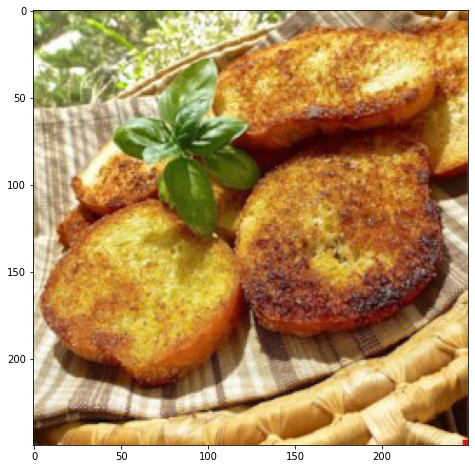

Garlic Crouton Slices:

Real:
black pepper
garlic powder
olive
onion powder
salt

Prediction:
black pepper
pepper
vegetables
butter
carrot
onion
cloves garlic
salt
chicken


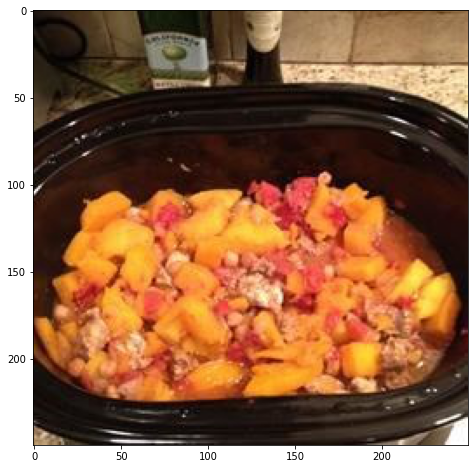

Chicken and Pumpkin Goulash:

Real:
tomato
water
ground cumin
pumpkin
ginger
sugar
onion
olive
cinnamon
salt
chicken
bean

Prediction:
black pepper
lemon
butter
garlic powder
parmesan
bread
salt
egg

Epoch 1 train loss:	2.7149
Эпоха 2


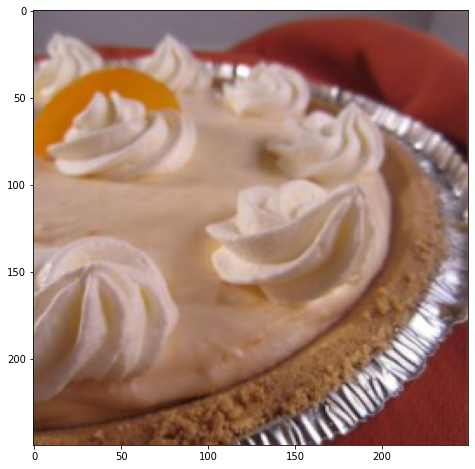

Quick and Easy Peach Cheesecake:

Real:
peach
vanilla
sugar
cracker
cream cheese

Prediction:
flour
baking soda
butter
vanilla
sugar
buttermilk
baking powder
salt
egg


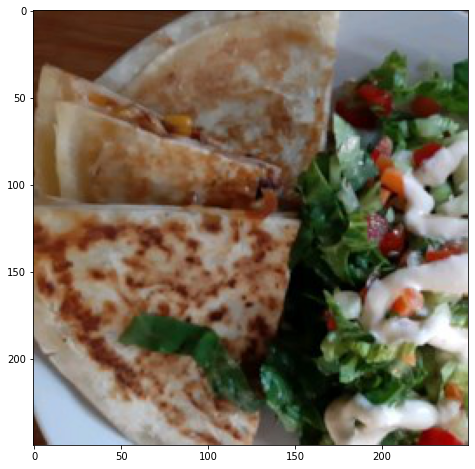

Black Bean and Corn Quesadillas:

Real:
flour
butter
cheese
red pepper
olive
onion
sugar
corn
bean
salsa

Prediction:
black pepper
lemon
butter
garlic powder
paprika
salmon
olive
salt
chicken

Epoch 2 train loss:	2.2200
Эпоха 3


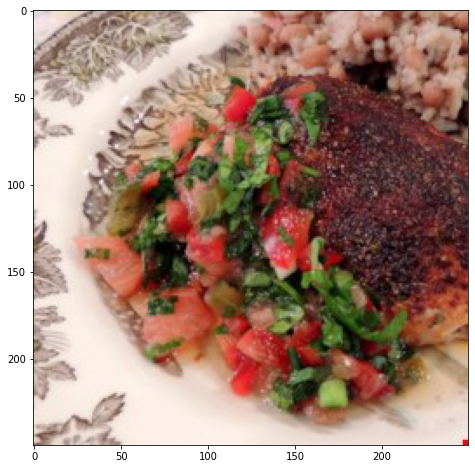

Sweet and Spicy Salmon with Grapefruit Salsa:

Real:
black pepper
pepper
thyme
garlic powder
paprika
jalapeno
salmon
red pepper
sugar
onion powder
onion
cilantro
salt
corn
oregano

Prediction:
black pepper
lemon
butter
garlic powder
salt
chicken


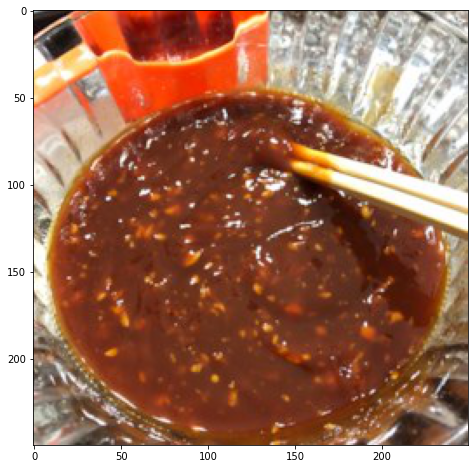

Tonkatsu Sauce:

Real:
clove
sauce
wine
ginger
ketchup
sugar
soy sauce

Prediction:
water
lemon
sugar
vinegar
salt

Epoch 3 train loss:	2.0661
Эпоха 4


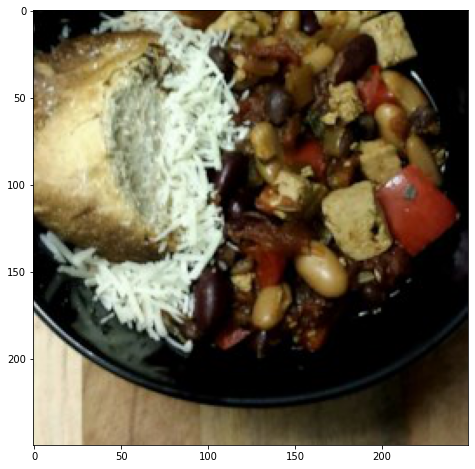

Meatiest Vegetarian Chili From Your Slow Cooker:

Real:
green pepper
tomato
black pepper
pepper
tofu
ground cumin
red pepper
olive
onion
cloves garlic
vinegar
salt
bean
oregano

Prediction:
black pepper
pepper
flour
vegetables
butter
sauce
mustard
onion
cloves garlic
salt
chicken


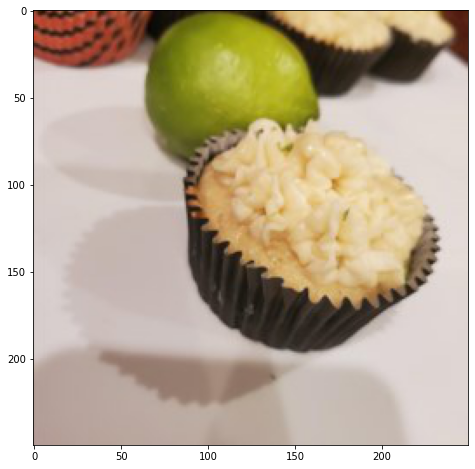

Coconut-Lime Cupcakes:

Real:
flour
coconut
butter
nutmeg
vanilla
sugar
lime
buttermilk
baking powder
egg

Prediction:
black pepper
pepper
thyme
vegetables
garlic powder
paprika
onion powder
salt
oregano

Epoch 4 train loss:	1.9499
Эпоха 5


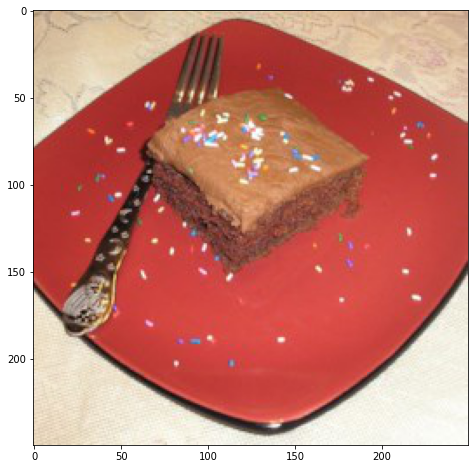

Best Chocolate Cake:

Real:
water
flour
baking soda
butter
milk
sugar
vanilla
vinegar
egg
cocoa

Prediction:
chocolate
flour
butter
vanilla
sugar
walnut
egg


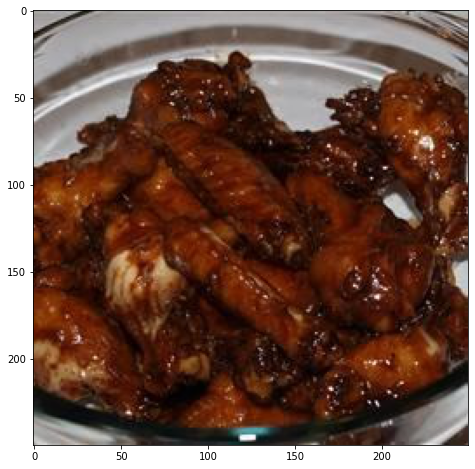

Chicken Wings Pacifica:

Real:
water
butter
mustard
sugar
chicken
soy sauce

Prediction:
black pepper
pepper
flour
thyme
butter
garlic powder
paprika
onion powder
salt
chicken

Epoch 5 train loss:	1.8416
Эпоха 6


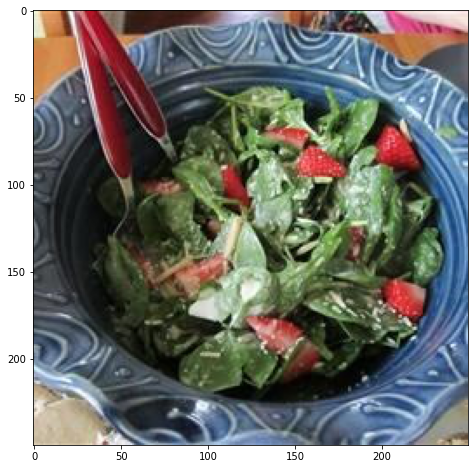

Chicken Strawberry Spinach Salad with Ginger-Lime Dressing:

Real:
spinach
black pepper
almond
garlic powder
mayonnaise
ginger
milk
lime
corn
chicken
strawberry

Prediction:
black pepper
lemon
clove
olive
salt
brussels sprout


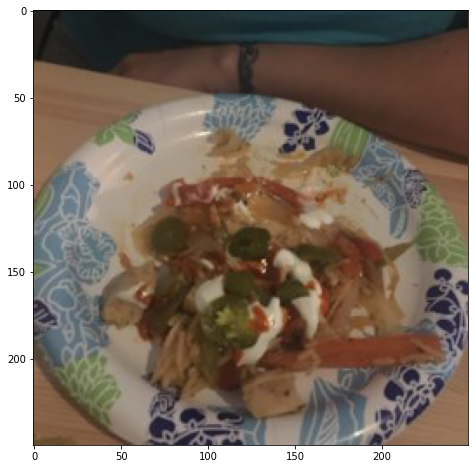

Fajita Chicken & Rice Skillet:

Real:
green pepper
water
butter
onion
rice
chicken

Prediction:
spinach
pasta
tomato
olive
cloves garlic
chicken

Epoch 6 train loss:	1.7271
Эпоха 7


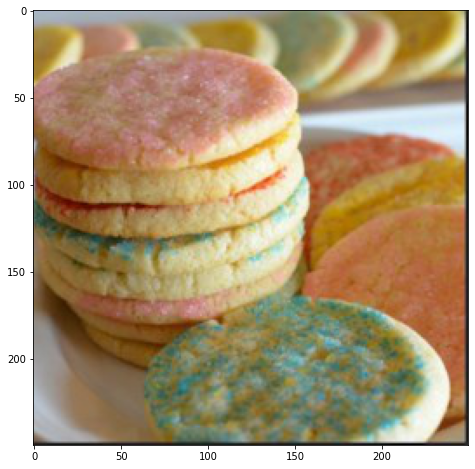

Refrigerator Cookies I:

Real:
flour
butter
vanilla
sugar
baking powder
salt
egg

Prediction:
flour
butter
vanilla
sugar
milk
baking powder
salt
egg


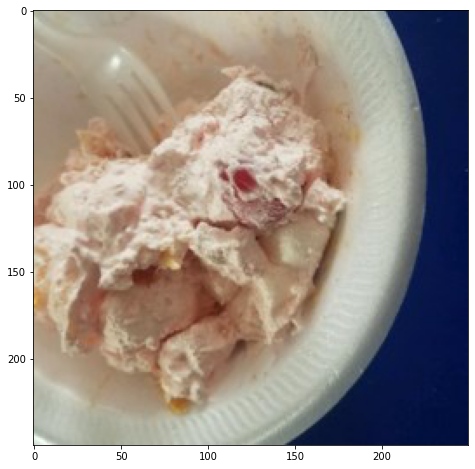

Ambrosia Fruit Salad:

Real:
cherry
coconut
nutmeg
walnut
cinnamon
pineapple
fruit
orange

Prediction:
water
black pepper
flour
butter
potato
onion
milk
salt
celery
ham
chicken
parsley

Epoch 7 train loss:	1.6113
Эпоха 8


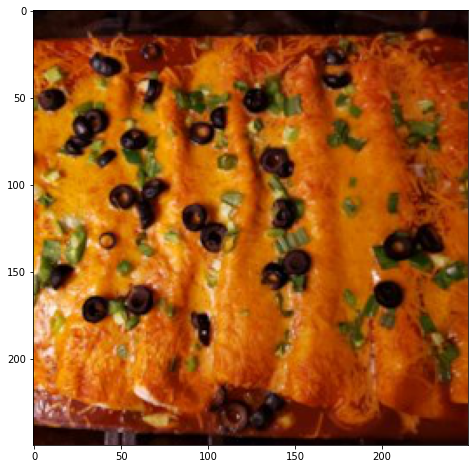

Angela's Awesome Enchiladas:

Real:
taco
water
flour
butter
garlic powder
cheddar
sauce
onion
lime
onion powder
olive
chicken
sour cream

Prediction:
spinach
black pepper
flour
butter
cheddar
milk
onion
salt
sour cream


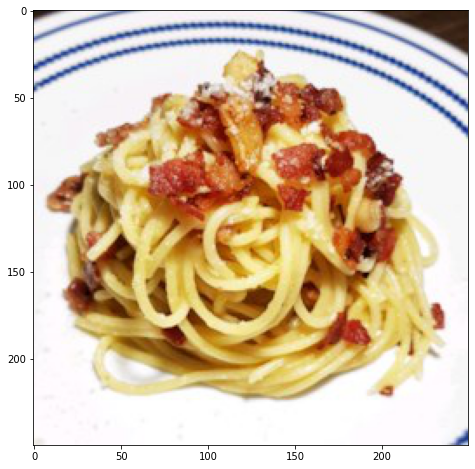

Spaghetti Alla Carbonara Tradizionali:

Real:
black pepper
cheese
egg yolk
spaghetti
egg

Prediction:
pasta
tomato
black pepper
parmesan
olive
cloves garlic
basil
salt

Epoch 8 train loss:	1.4966
Эпоха 9


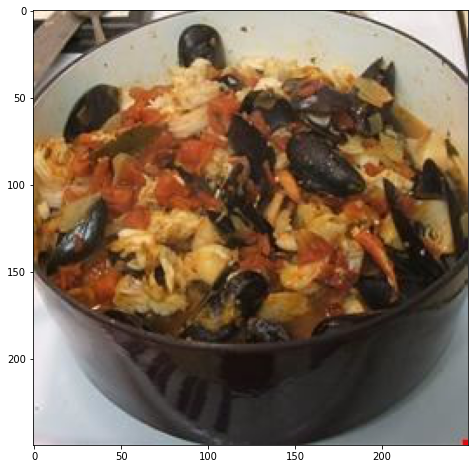

Bodega Bay Cioppino:

Real:
tomato
black pepper
crab
shrimp
scallop
wine
clam
olive
onion
cloves garlic
basil
salt
parsley

Prediction:
green pepper
tomato
water
black pepper
beef
ground cumin
olive
onion
cloves garlic
salt
bean


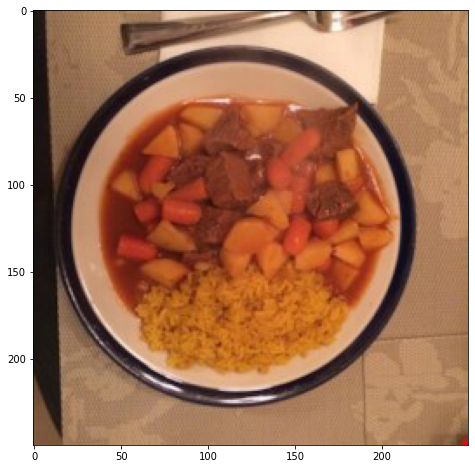

Carne Guisada III:

Real:
tomato
water
beef
sauce
potato
salt
oregano

Prediction:
tomato
black pepper
beef
carrot
potato
onion
salt
celery

Epoch 9 train loss:	1.3945
Эпоха 10


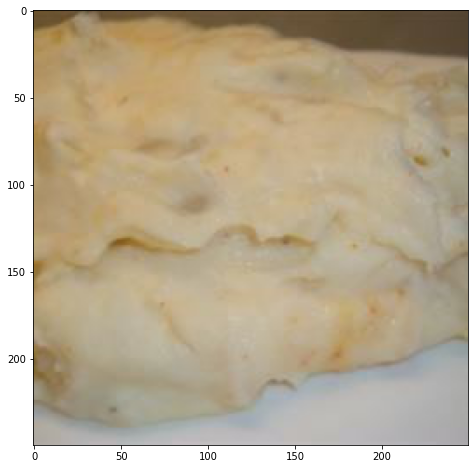

Loaded Baby Reds:

Real:
pepper
cheddar
garlic powder
potato
parmesan
cream cheese
bacon

Prediction:
water
flour
butter
potato
onion
milk
salt


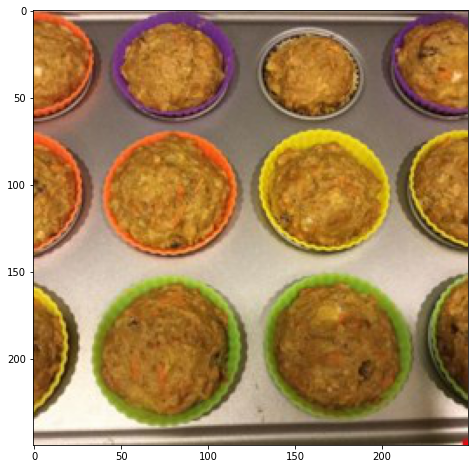

Carrot Oatmeal Muffins:

Real:
flour
coconut
baking soda
oil
raisin
carrot
cereals
vanilla
sugar
cinnamon
baking powder
salt
pineapple
cream cheese
egg

Prediction:
black pepper
pepper
flour
vegetables
garlic powder
paprika
salt

Epoch 10 train loss:	1.3082
Эпоха 11


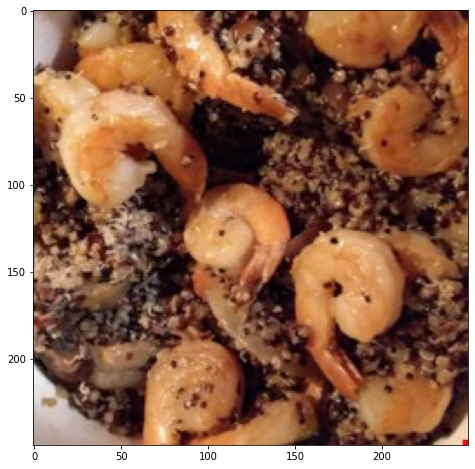

Shrimp Quinoa:

Real:
lemon
shrimp
asparagus
red pepper
olive
onion
cloves garlic
mushroom
ginger
raisin
salt
chicken

Prediction:
black pepper
water
flour
vegetables
garlic powder
onion
salt
chicken
egg


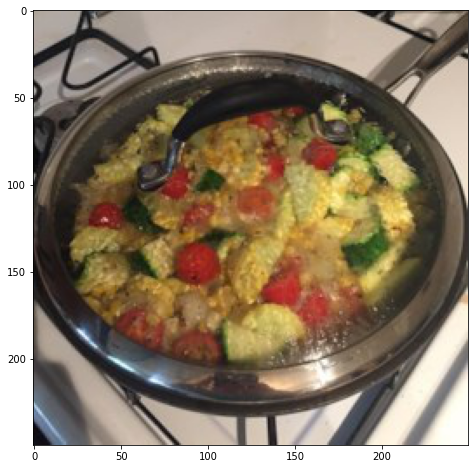

Garlicky Summer Squash and Fresh Corn:

Real:
vegetables
squash
butter
zucchini
olive
onion
cloves garlic
salt
corn
parsley

Prediction:
green pepper
water
black pepper
pepper
flour
thyme
shrimp
butter
onion
salt
celery
garlic
parsley
sausage
bacon

Epoch 11 train loss:	1.2369
Эпоха 12


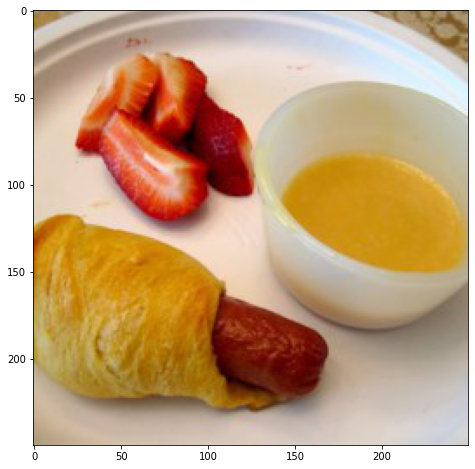

Honey Mustard Sauce:

Real:
honey
mustard
mayonnaise

Prediction:
water
lemon
clove
sugar
cinnamon
pineapple
orange


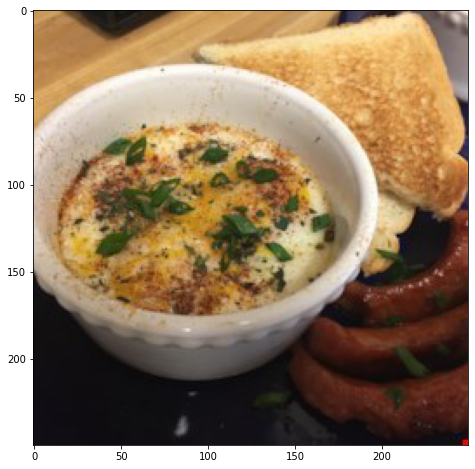

Shirred Eggs:

Real:
butter
parmesan
salt
chives
egg

Prediction:
black pepper
pepper
ground cumin
garlic powder
paprika
mustard
sugar
onion powder
cinnamon
salt
oregano

Epoch 12 train loss:	1.1816
Эпоха 13


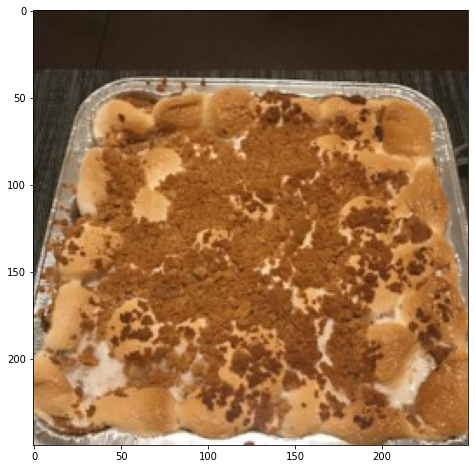

S'mores at Home:

Real:
chocolate
sugar
butter
cracker

Prediction:
flour
butter
nutmeg
apple
sugar
cinnamon
salt


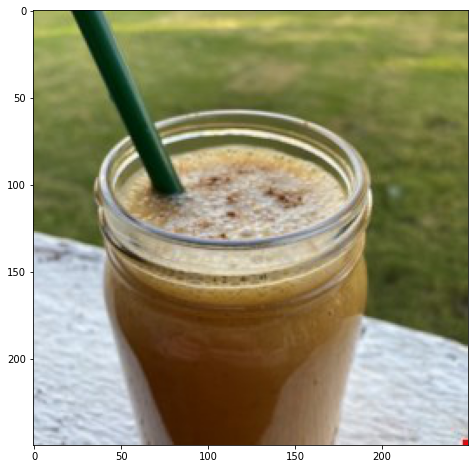

Vegan Pumpkin Pie Smoothie:

Real:
ice
water
pumpkin
almond milk

Prediction:
milk
sugar
vanilla
banana
egg

Epoch 13 train loss:	1.1347
Эпоха 14


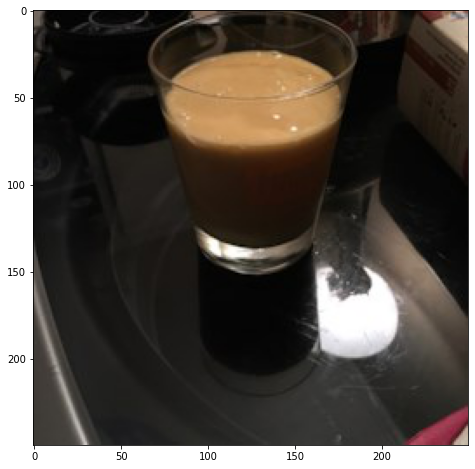

Mango Oatmeal Breakfast Smoothie:

Real:
mango
banana
yogurt
orange

Prediction:
water
lemon
clove
alcohol
nutmeg


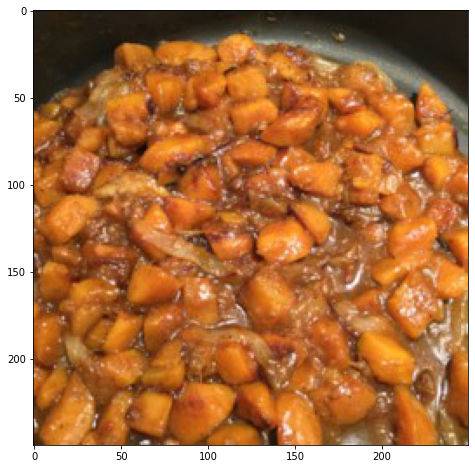

Curried Kabocha:

Real:
coconut
sesame
squash
ginger
onion
sugar
salt
fish

Prediction:
black pepper
pepper
sauce
garlic powder
paprika
carrot
syrup
red pepper
onion
olive
celery
chicken

Epoch 14 train loss:	1.0970
Эпоха 15


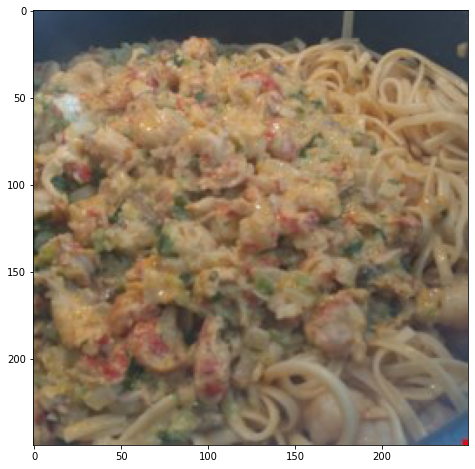

Louisiana Crawfish Ya-Ya Pasta:

Real:
green pepper
clove
butter
cheddar
onion
mushroom
parsley
egg

Prediction:
pasta
black pepper
lemon
shrimp
butter
wine
olive
cloves garlic
basil
salt
chicken
parsley


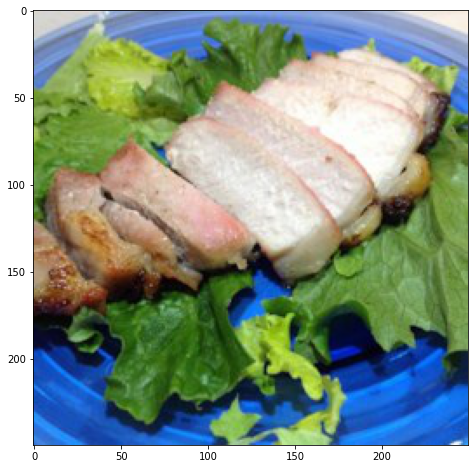

Pomegranate Marinated Pork Chops:

Real:
black pepper
clove
pomegranate
olive
salt

Prediction:
black pepper
lemon
shrimp
paprika
olive
sugar
basil
garlic

Epoch 15 train loss:	1.0648
Эпоха 16


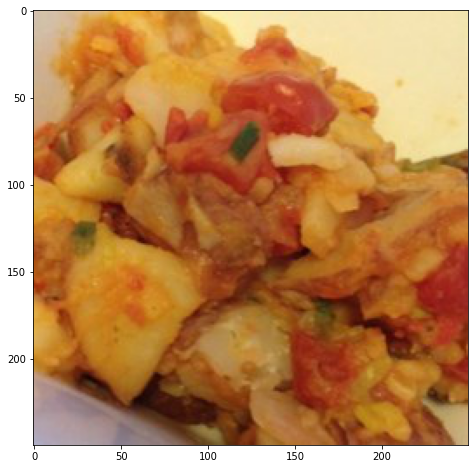

Potatoes with Fresh Ginger and Chilies:

Real:
green pepper
tomato
potato
ginger
oil
salt
turmeric

Prediction:
green pepper
tomato
black pepper
shrimp
butter
sauce
onion
rice
salt
celery
garlic
chicken
parsley
sausage


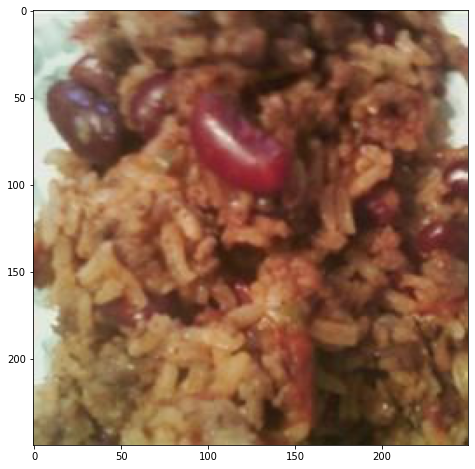

Cajun Chow Mein:

Real:
green pepper
tomato
water
black pepper
beef
onion
rice
garlic
bean

Prediction:
green pepper
tomato
black pepper
beef
onion
cloves garlic
basil
salt
oregano

Epoch 16 train loss:	1.0377
Эпоха 17


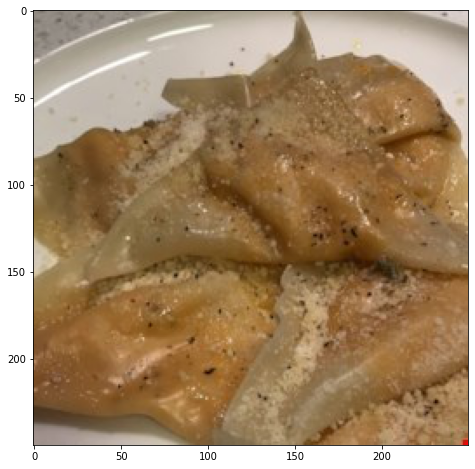

Easy Butternut Squash Ravioli:

Real:
black pepper
pepper
clove
squash
cheese
egg yolk
butter
parmesan
salt

Prediction:
black pepper
lemon
butter
sugar
cloves garlic
soy sauce


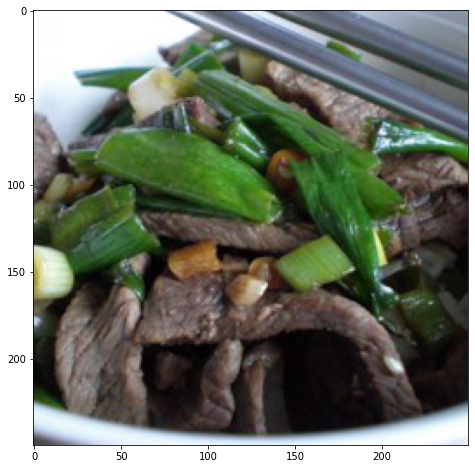

Authentic Korean Bulgogi:

Real:
black pepper
beef
sesame
wine
sugar
onion
mushroom
garlic
juice
soy sauce

Prediction:
black pepper
green bean
sesame
olive
salt
chicken

Epoch 17 train loss:	1.0152
Эпоха 18


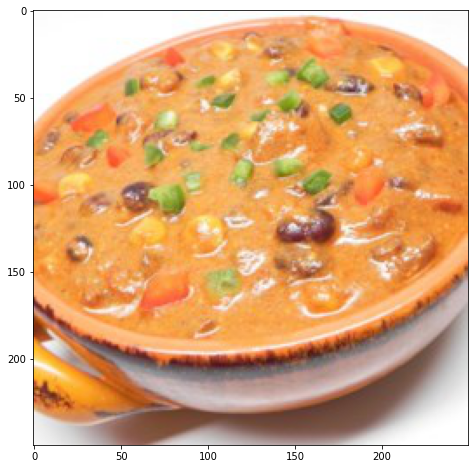

Cheesy Black Bean and Corn Chili:

Real:
tomato
water
beef
cheese
onion
corn
bean

Prediction:
tomato
black pepper
flour
beef
thyme
carrot
mustard
potato
olive
onion
cloves garlic
mushroom
sugar
beer


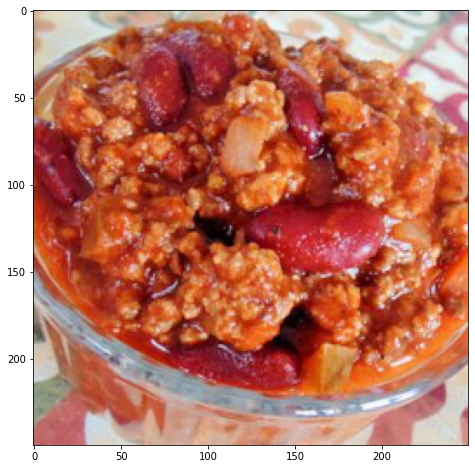

Joan's Quick Chili:

Real:
green pepper
tomato
clove
beef
onion
oil
salt
bean

Prediction:
water
tomato
black pepper
beef
onion
basil
spaghetti
salt
parsley

Epoch 18 train loss:	0.9948
Эпоха 19


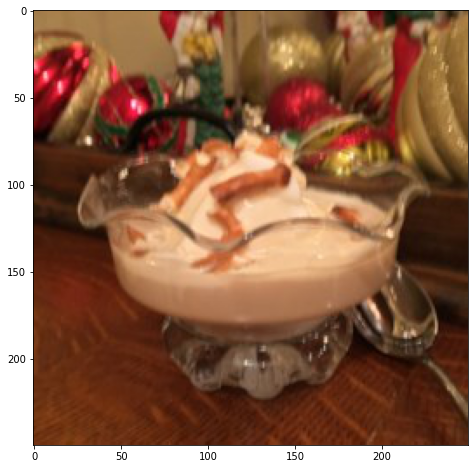

Baileys Ice Cream Sundae:

Real:
ice cream

Prediction:
chocolate
flour
butter
vanilla
sugar
salt
egg


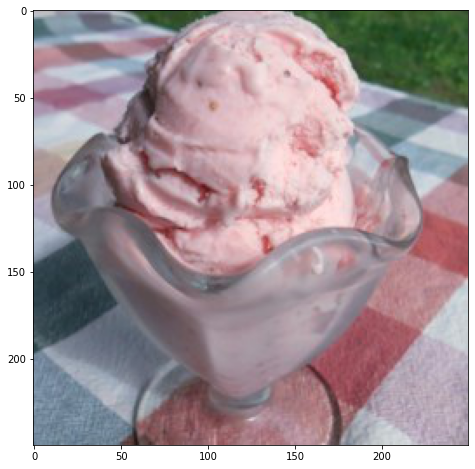

Chef John's Strawberry Ice Cream:

Real:
vanilla
milk
sugar
whipped cream
salt
strawberry

Prediction:
chocolate
flour
butter
vanilla
sugar
milk
baking powder
salt
cream cheese
egg

Epoch 19 train loss:	0.9773
Эпоха 20


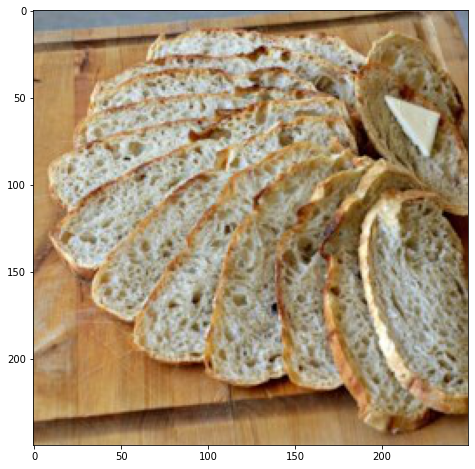

No-Knead Artisan Style Bread:

Real:
thyme
water
flour
salt

Prediction:
flour
vegetables
baking soda
raisin
nutmeg
zucchini
vanilla
sugar
walnut
cinnamon
pineapple
salt
baking powder
egg


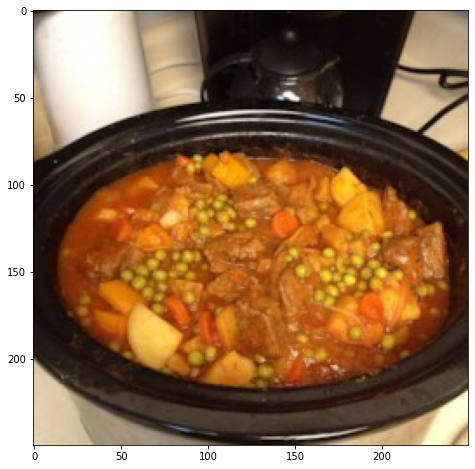

Beef and Vegetable Stew:

Real:
tomato
beef
vegetables
thyme
carrot
pea
potato
onion
red pepper
mushroom

Prediction:
tomato
black pepper
water
beef
carrot
potato
onion
rice
salt

Epoch 20 train loss:	0.9615
Эпоха 21


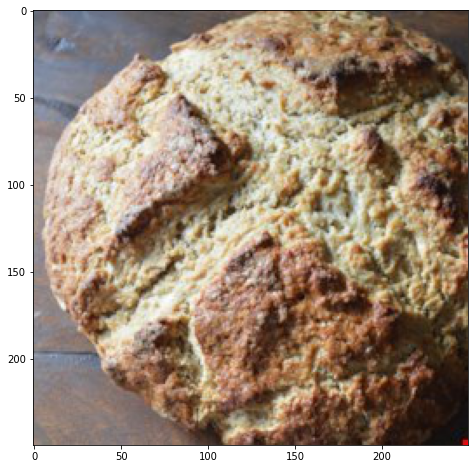

Perfectly Moist Irish Wheaten Bread:

Real:
flour
vegetables
baking soda
bread
sugar
buttermilk
salt
margarine

Prediction:
flour
baking soda
butter
apple
sugar
walnut
cinnamon
baking powder
salt
egg


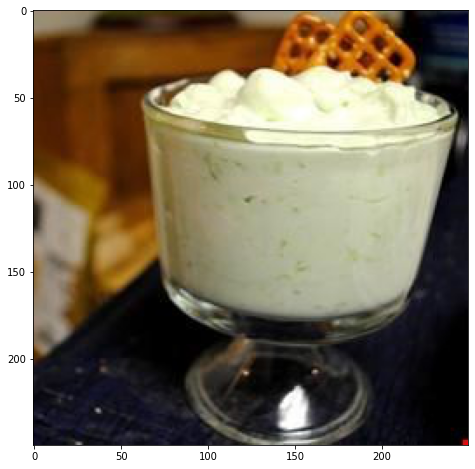

Instant Pistachio Salad:

Real:
pudding mix
pineapple

Prediction:
milk
sugar
vanilla
nutmeg

Epoch 21 train loss:	0.9473
Эпоха 22


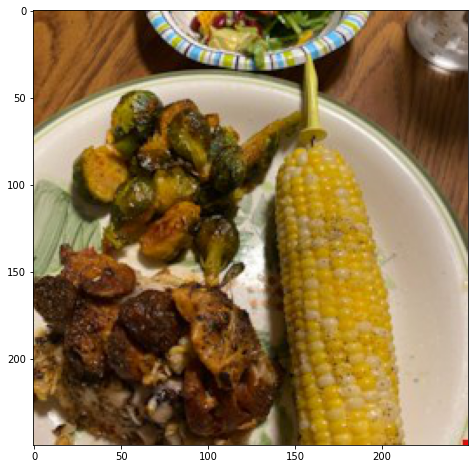

Spicy Stuffed Chicken Thighs:

Real:
green pepper
tomato
red pepper
onion
chicken
sausage

Prediction:
black pepper
lemon
pepper
ground cumin
avocado
garlic powder
paprika
onion powder
salt
chicken
yogurt


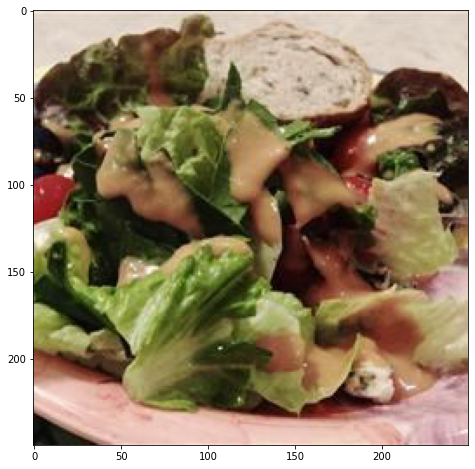

Aunt Betty's French Dressing:

Real:
vegetables
sauce
paprika
wine
ketchup
onion
sugar

Prediction:
black pepper
lemon
clove
red pepper
olive

Epoch 22 train loss:	0.9347
Эпоха 23


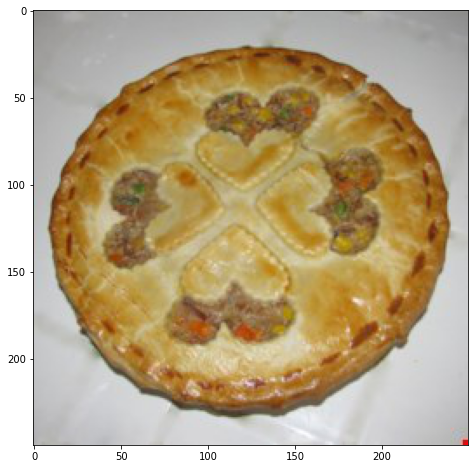

Turkey Pot Pie II:

Real:
turkey
vegetables
milk
onion
chicken
dough

Prediction:
flour
butter
peach
milk
sugar
baking powder


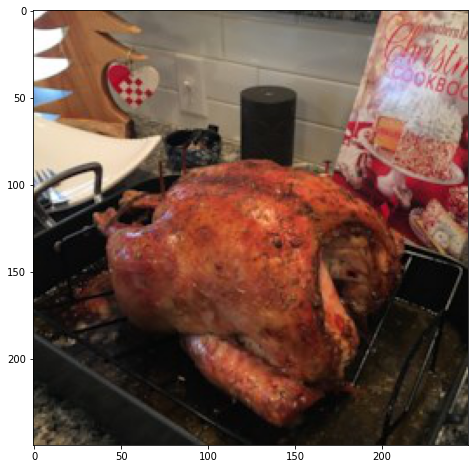

Rosemary Roasted Turkey:

Real:
black pepper
turkey
olive
basil
salt
garlic

Prediction:
black pepper
pepper
thyme
ground cumin
garlic powder
paprika
nutmeg
sugar
onion powder
salt
oregano

Epoch 23 train loss:	0.9223
Эпоха 24


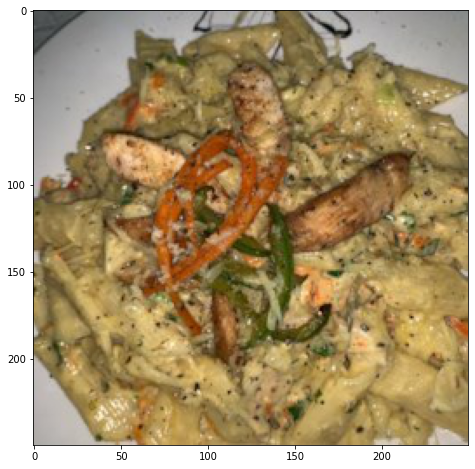

Alfredo Chicken:

Real:
pasta
chicken
garlic powder
sauce

Prediction:
black pepper
lemon
butter
garlic powder
red pepper


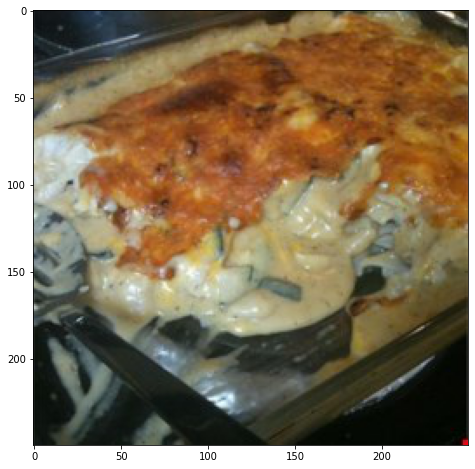

Cheesy Flounder Florentine:

Real:
spinach
black pepper
flour
butter
cheese
mustard
nutmeg
milk
parmesan
chicken

Prediction:
black pepper
lemon
butter
mayonnaise
parmesan
onion powder
basil
celery

Epoch 24 train loss:	0.9121
Эпоха 25


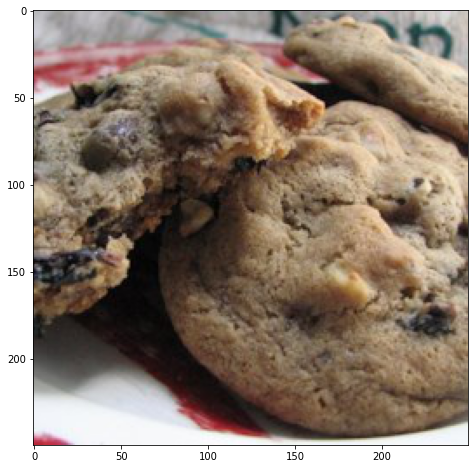

Cherry Chocolate Chunk Cookies:

Real:
chocolate
flour
cherry
almond
baking soda
butter
pecan
vanilla
sugar
walnut
salt
egg

Prediction:
flour
baking soda
butter
sugar
walnut
cinnamon
baking powder
salt
egg
orange


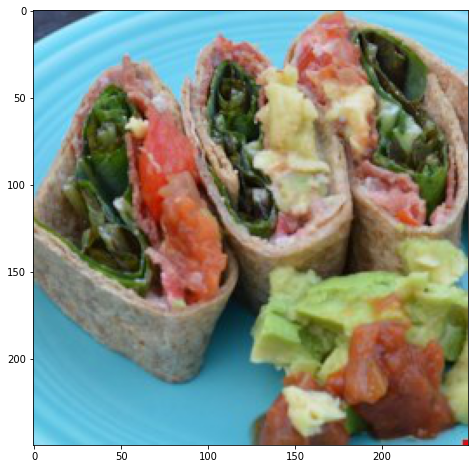

BLT Rollers:

Real:
tomato
flour
lettuce
mayonnaise
cream cheese
bacon

Prediction:
black pepper
pepper
tomato
ground cumin
garlic powder
paprika
jalapeno
cheese
olive
lime
cloves garlic
vinegar
onion
salt
cilantro
corn
fruit
oregano
soy sauce

Epoch 25 train loss:	0.9016


In [74]:
epoch_losses = defaultdict(list)

encoder.train()
decoder.train()

torch.manual_seed(42)
torch.backends.cudnn.benchmark = True
train(encoder, decoder, criterion, optimizer, num_epochs=25, epoch_losses=epoch_losses,
      log_step=250)

Эпоха 26


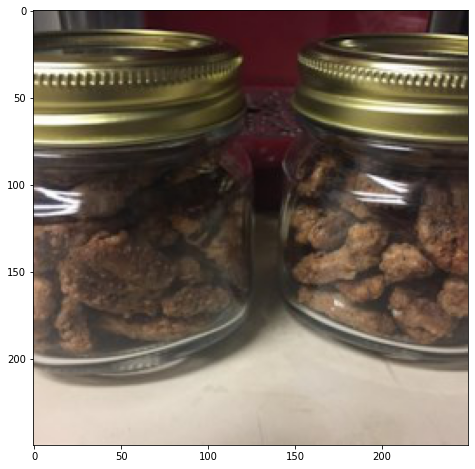

Texas Glazed Pecans:

Real:
water
pecan
vanilla
sugar
cinnamon
salt
egg

Prediction:
black pepper
pepper
beef
vegetables
paprika
mustard
cloves garlic


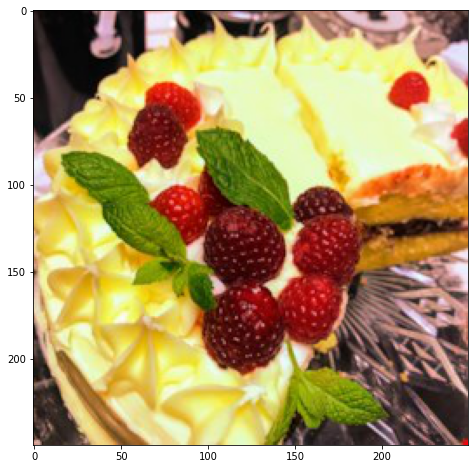

Special Buttercream Frosting:

Real:
vanilla
sugar
salt

Prediction:
flour
butter
vanilla
sugar
milk
baking powder
salt
egg

Epoch 26 train loss:	0.8929
Эпоха 27


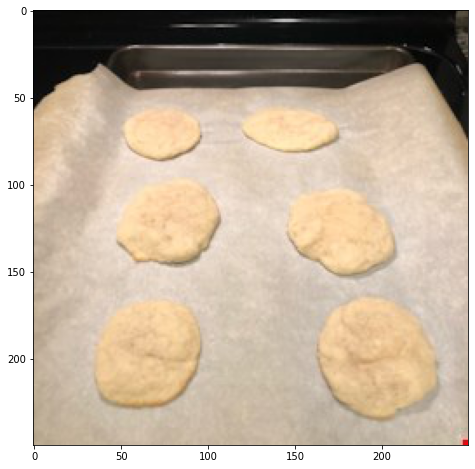

Unleavened Bread for Communion:

Real:
vegetables
water
flour
salt

Prediction:
flour
butter
vanilla
sugar
baking powder
salt
egg


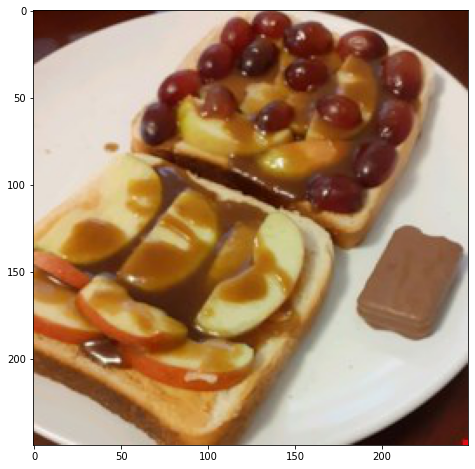

Breakfast Rounds:

Real:
peanut butter
muffin
apple
sugar
cinnamon
margarine

Prediction:
flour
butter
milk
sugar
vanilla
baking powder
salt
cranberry

Epoch 27 train loss:	0.8843
Эпоха 28


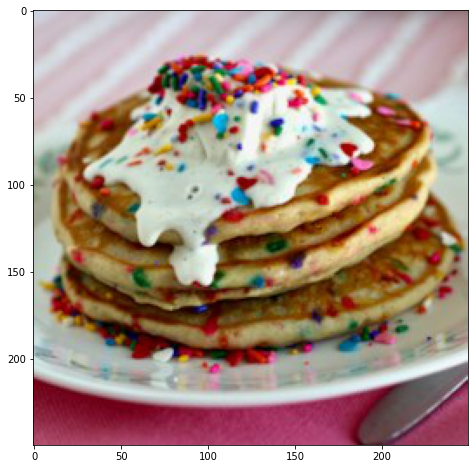

Funfetti® Pancakes with Vanilla Cream Sprinkle Sauce:

Real:
flour
baking soda
butter
vanilla
sugar
buttermilk
baking powder
salt
egg
whipped cream

Prediction:
flour
vegetables
baking soda
butter
vanilla
sugar
walnut
banana
cinnamon
pineapple
salt
cream cheese
egg


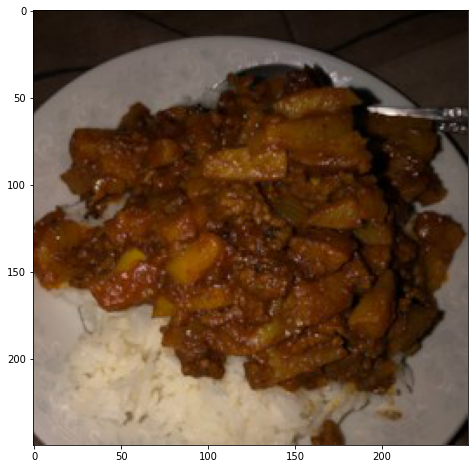

South Asian-Style Ground Beef (Keema):

Real:
black pepper
pepper
tomato
clove
beef
butter
ginger
onion
potato
cinnamon
salt
turmeric

Prediction:
black pepper
pepper
flour
vegetables
sauce
pickle
butter
paprika
garlic powder
sugar
buttermilk
lard
salt
chicken
egg

Epoch 28 train loss:	0.8766
Эпоха 29


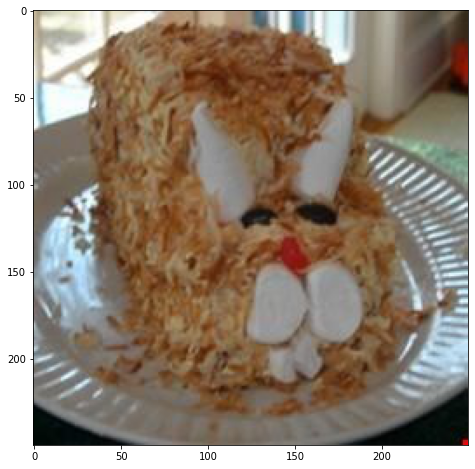

Coconut Layer Cake:

Real:
water
flour
almond
coconut
milk
sugar
vanilla
baking powder
salt
corn
egg

Prediction:
flour
vegetables
coconut
baking soda
butter
carrot
vanilla
sugar
walnut
cinnamon
pineapple
salt
cream cheese
egg


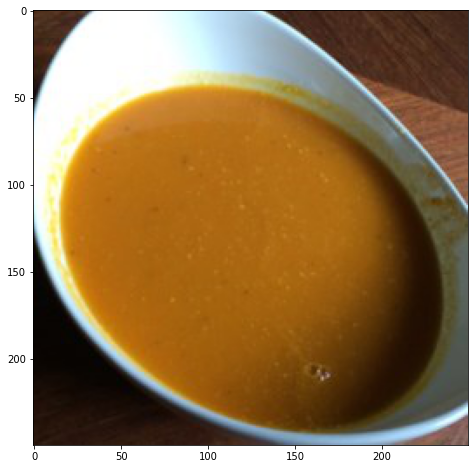

Roasted Butternut Squash Soup:

Real:
butter
squash
carrot
pumpkin
olive
onion
bread
cinnamon
salt
celery
chicken

Prediction:
water
tomato
black pepper
carrot
wine
olive
onion
garlic
lentil
oregano

Epoch 29 train loss:	0.8694
Эпоха 30


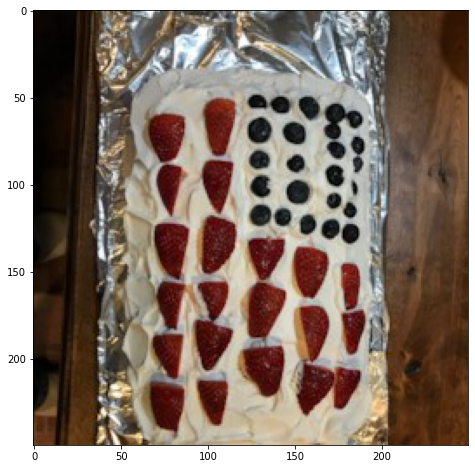

Red, White and Blue Strawberry Shortcake:

Real:
strawberry
blueberry
cake mix

Prediction:
pudding mix
milk
banana
strawberry


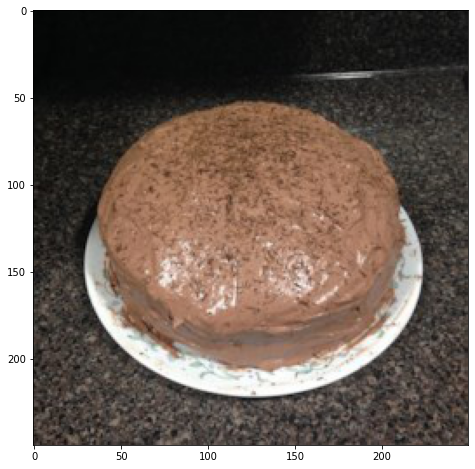

Chocolate Mousse Cake IV:

Real:
chocolate
water
pudding mix
cake mix
milk
whipped cream

Prediction:
chocolate
flour
butter
vanilla
sugar
walnut
milk
egg

Epoch 30 train loss:	0.8619
Эпоха 31


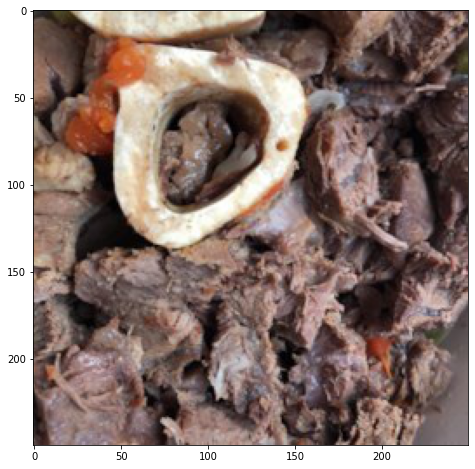

Mom and Micki's Beef Shank Vegetable Soup:

Real:
green pepper
water
tomato
black pepper
clove
beef
carrot
potato
onion
salt
parsley

Prediction:
black pepper
beef
vegetables
butter
carrot
onion
salt
celery


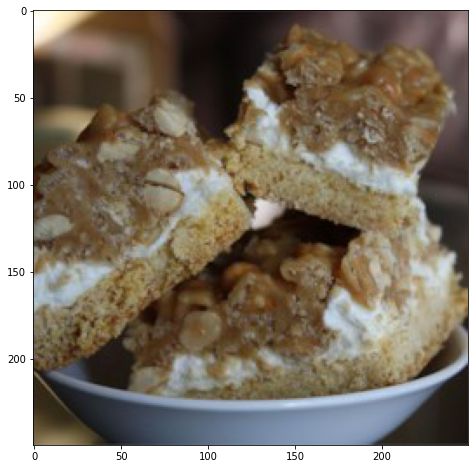

Peanut Mallow Bars:

Real:
water
peanut butter
butter
cake mix
vanilla
rice
corn
egg

Prediction:
flour
vegetables
baking soda
apple
vanilla
sugar
cinnamon
salt
egg

Epoch 31 train loss:	0.8549
Эпоха 32


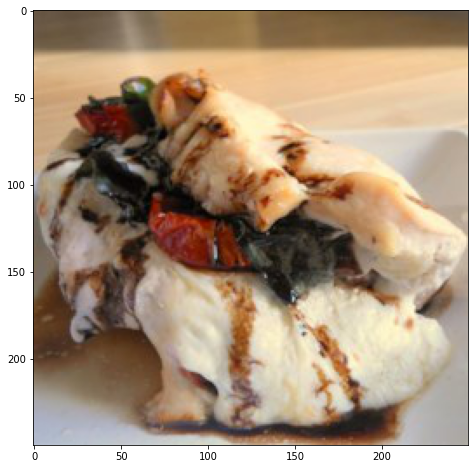

Caprese-Stuffed Chicken Breast with Balsamic Reduction:

Real:
black pepper
tomato
olive
onion powder
vinegar
basil
salt
garlic
chicken
mozzarella

Prediction:
black pepper
lemon
mustard
mayonnaise
salmon
olive
cloves garlic
salt


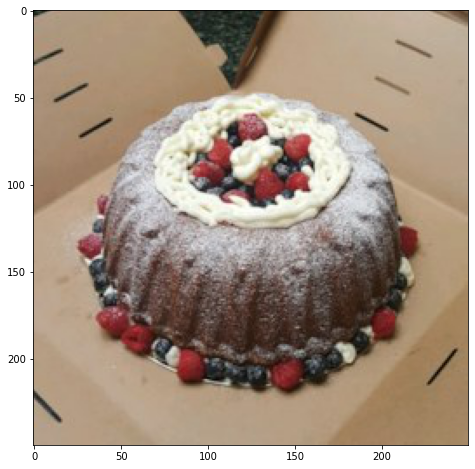

Cream Cheese Pound Cake I:

Real:
flour
almond
butter
vanilla
sugar
cream cheese
egg

Prediction:
chocolate
water
flour
cherry
baking soda
milk
sugar
baking powder
oil
salt
egg
cocoa

Epoch 32 train loss:	0.8476
Эпоха 33


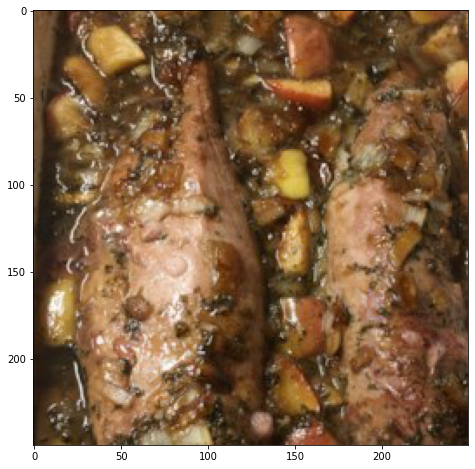

Apple Glazed Pork Tenderloin:

Real:
black pepper
wine
apple
olive
onion
vinegar
parsley

Prediction:
black pepper
water
beef
wine
olive
onion
celery


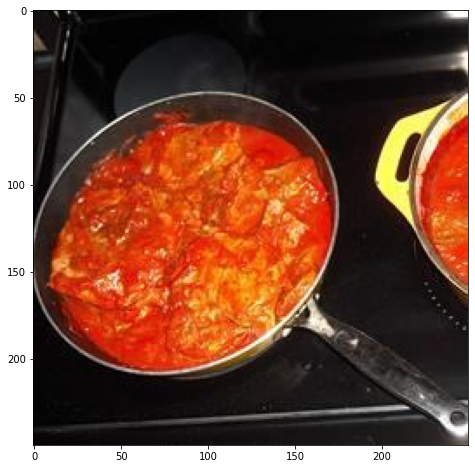

Tomato Chops I:

Real:
tomato
water
vegetables
onion
celery
garlic

Prediction:
tomato
pepper
ground cumin
paprika
olive
onion
cloves garlic
salt
egg
bell pepper

Epoch 33 train loss:	0.8423
Эпоха 34


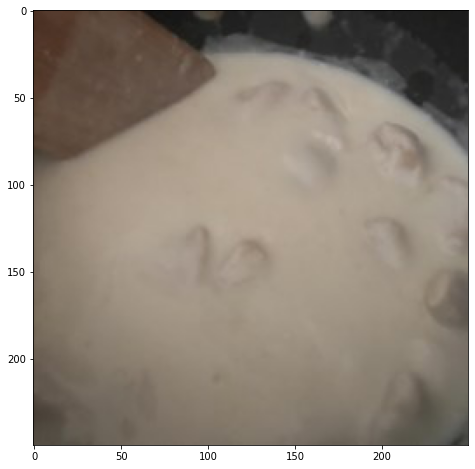

Fettuccini Alfredo I:

Real:
pasta
pepper
flour
butter
milk
parmesan
garlic

Prediction:
milk
lime
sour cream
cracker


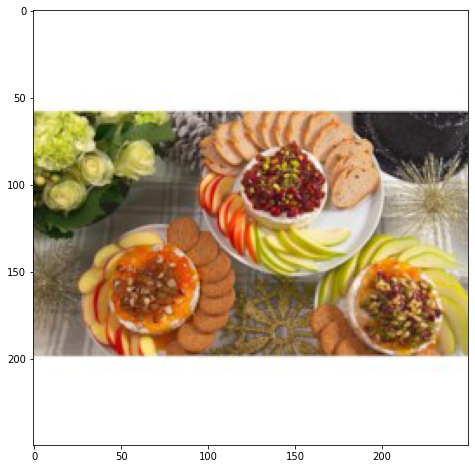

Baked Brie with Caramelized Onions and Hazelnuts:

Real:
pecan
butter
cheese
apple
onion
bread
apricot

Prediction:
water
flour
vegetables
butter
milk
sugar
vanilla
cinnamon
salt
egg

Epoch 34 train loss:	0.8360
Эпоха 35


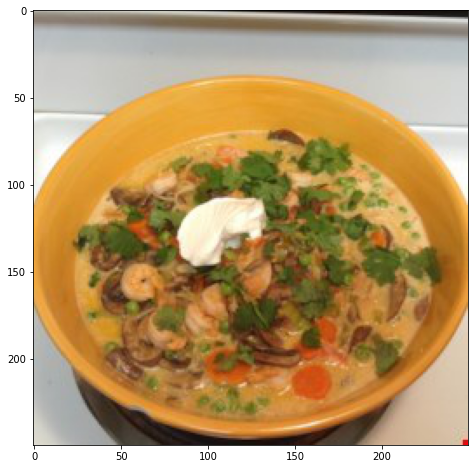

Coconut Milk Shrimp Soup:

Real:
pasta
tomato
shrimp
clove
vegetables
ground cumin
coconut
carrot
jalapeno
pea
onion
lime
mushroom
cilantro
salt
turmeric

Prediction:
tomato
pepper
shrimp
coconut
red pepper
olive
onion
cloves garlic
lime
mushroom
salt
basil
cilantro
chicken
fish


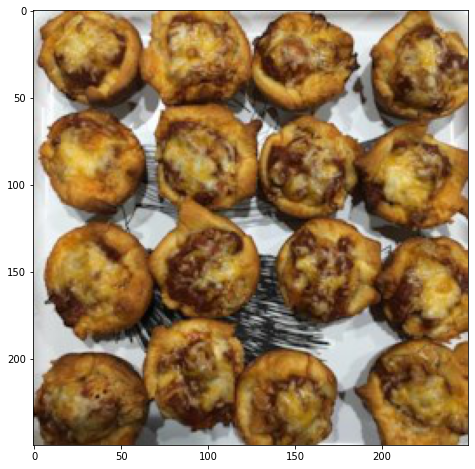

Parmesan Chicken Mini Pies:

Real:
parmesan
chicken
tomato
dough

Prediction:
black pepper
cheese
olive
salt
garlic
chicken
oregano

Epoch 35 train loss:	0.8308
Эпоха 36


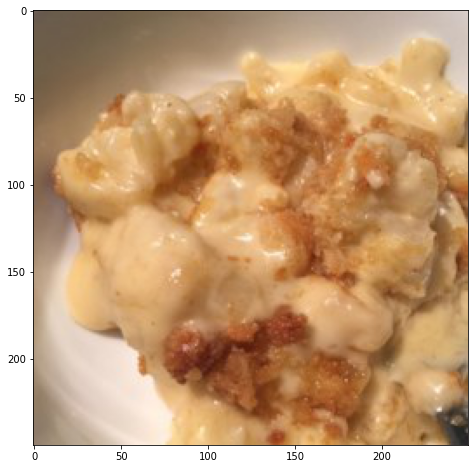

Cauliflower "Mac and Cheese" Bake:

Real:
flour
mustard
milk
onion
parmesan
bread
cracker
margarine

Prediction:
water
flour
butter
peach
milk
sugar
cinnamon
baking powder
salt


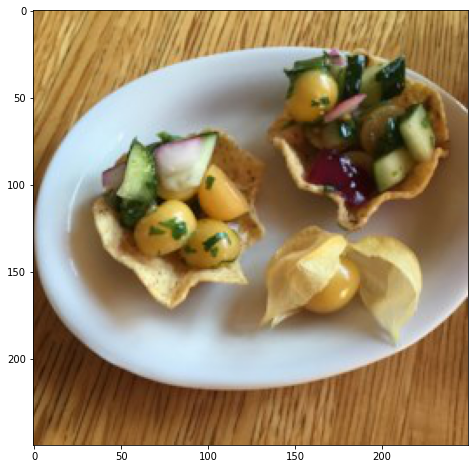

Ground Cherry Salsa:

Real:
cucumber
cherry
jalapeno
onion
lime
cherry tomato
cilantro
salt

Prediction:
black pepper
pepper
vegetables
ground cumin
bell pepper
garlic powder
onion
onion powder
cilantro
lime
salt
chicken
oregano

Epoch 36 train loss:	0.8256
Эпоха 37


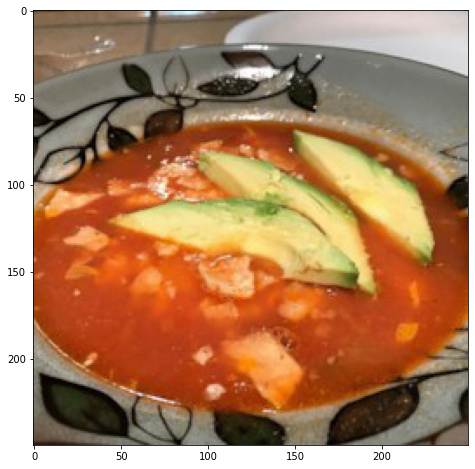

Tim's Turkey Tortilla Soup:

Real:
turkey
sauce
olive
cilantro
lime
tortilla
chicken

Prediction:
green pepper
tomato
water
black pepper
vegetables
sauce
onion
cilantro
cloves garlic
cumin
salt
corn
chicken


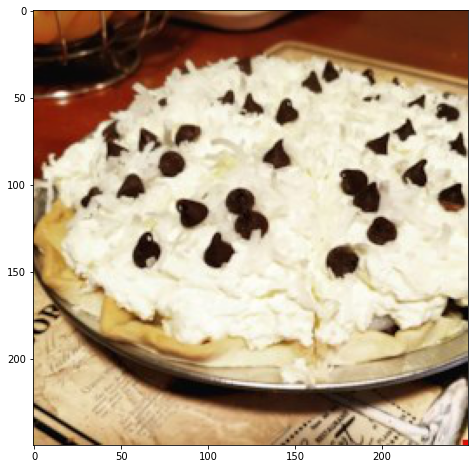

Coconut (Haupia) and Chocolate Pie:

Real:
chocolate
water
coconut
milk
sugar

Prediction:
pudding mix
milk
banana
vanilla

Epoch 37 train loss:	0.8208
Эпоха 38


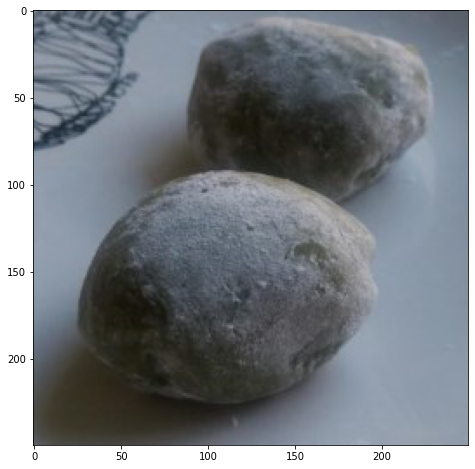

Green Tea Mochi Ice Cream:

Real:
water
sugar
rice
salt
ice cream
tea

Prediction:
water
flour
vegetables
milk
sugar
salt


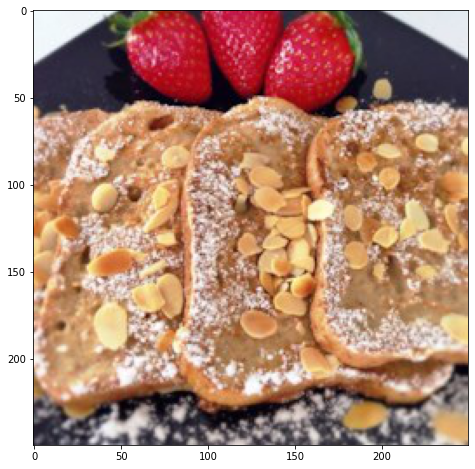

Vegan French Toast:

Real:
soy milk
flour
vanilla
sugar
bread
cinnamon

Prediction:
chocolate
flour
butter
vanilla
sugar
walnut

Epoch 38 train loss:	0.8156
Эпоха 39


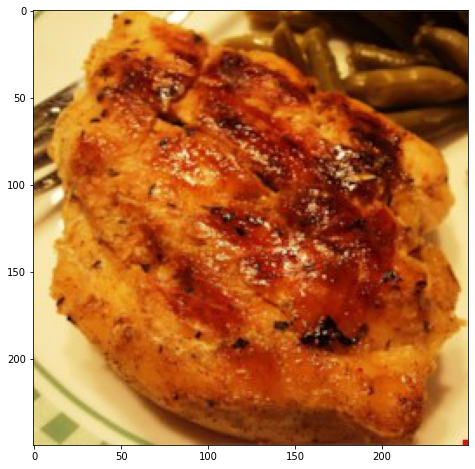

Bessy's Zesty Grilled Garlic-Herb Chicken:

Real:
pepper
thyme
olive
sugar
cloves garlic
basil
salt
honey
chicken
parsley
oregano

Prediction:
black pepper
lemon
butter
garlic powder
salt
chicken


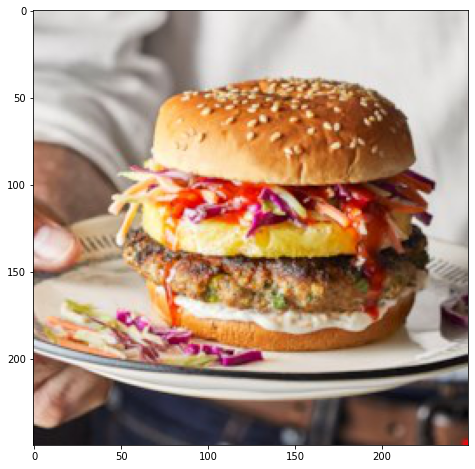

Thai-Style Turkey Burgers:

Real:
black pepper
turkey
ginger
onion
cilantro
cloves garlic
bread
egg
soy sauce

Prediction:
black pepper
beef
bun
sauce
cheese
garlic

Epoch 39 train loss:	0.8106
Эпоха 40


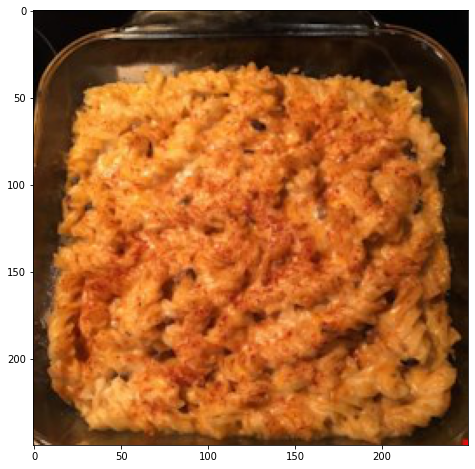

3-Cheese Pasta Bake:

Real:
pasta
black pepper
cheese
parmesan
milk
mushroom

Prediction:
black pepper
butter
milk
bread
sour cream


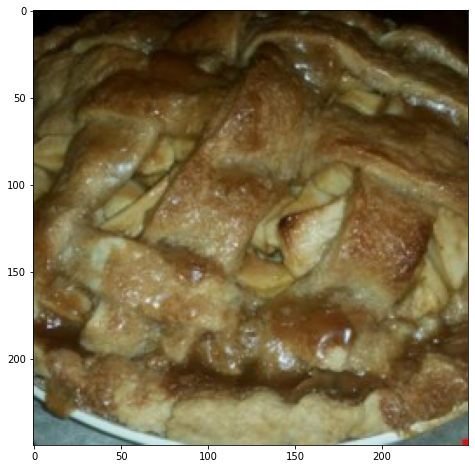

Mom's Pie Crust:

Real:
sugar
butter
flour
ice

Prediction:
water
flour
butter
apple
sugar
cinnamon
salt

Epoch 40 train loss:	0.8055
Эпоха 41


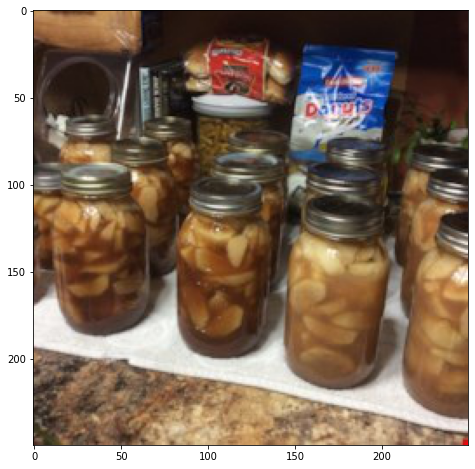

Canned Apple Pie Filling:

Real:
water
lemon
nutmeg
apple
sugar
cinnamon
salt

Prediction:
water
butter
apple
sugar
cinnamon
orange


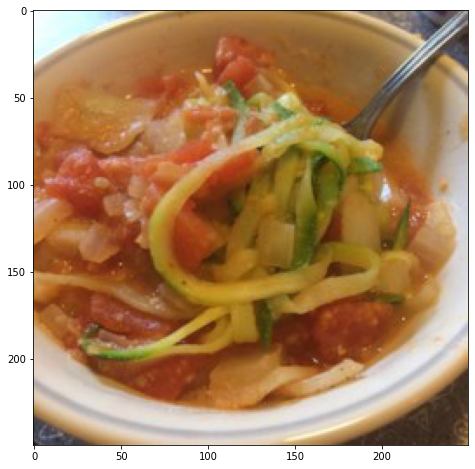

Bolognese on a Budget:

Real:
water
tomato
black pepper
vegetables
onion
lentil

Prediction:
green pepper
tomato
water
black pepper
vegetables
sauce
onion
cilantro
cloves garlic
cumin
salt
corn
chicken

Epoch 41 train loss:	0.8016
Эпоха 42


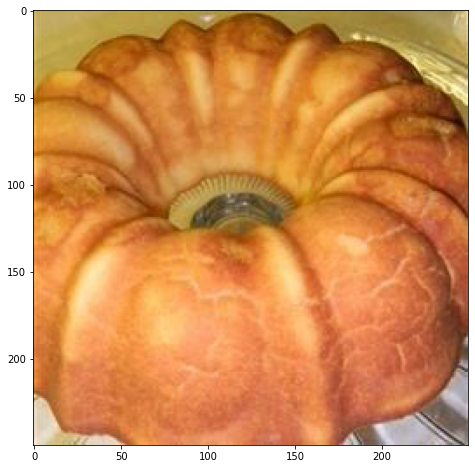

Butter Mochi Cake:

Real:
butter
vanilla
sugar
milk
rice
baking powder
egg
bean

Prediction:
lemon
flour
baking soda
butter
sugar
buttermilk
salt
egg


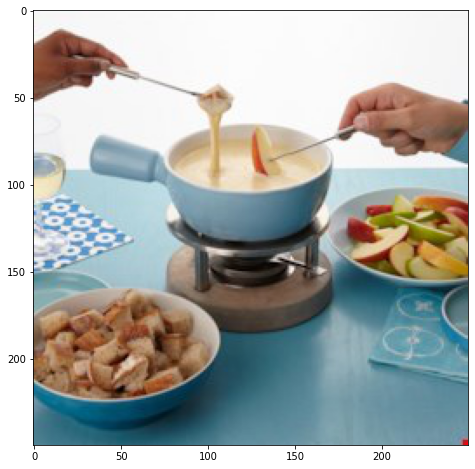

Cheese Fondue:

Real:
flour
cheese
nutmeg
wine
bread
salt

Prediction:
black pepper
pepper
flour
vegetables
ground cumin
sauce
mayonnaise
lime
cilantro
salt
honey
egg

Epoch 42 train loss:	0.7972
Эпоха 43


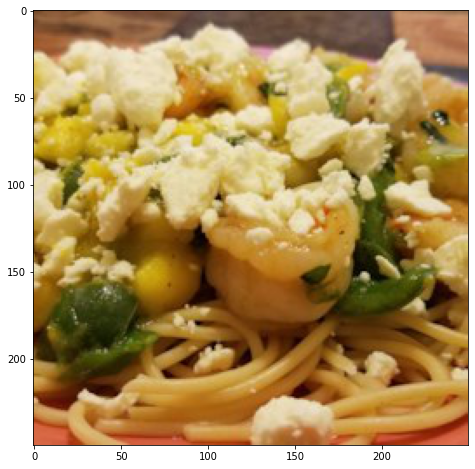

Mango-Basil Shrimp Skillet:

Real:
black pepper
pepper
shrimp
vegetables
mango
garlic powder
cheese
red pepper
basil
rice

Prediction:
pasta
black pepper
lemon
shrimp
butter
wine
olive
cloves garlic
basil
salt
chicken
parsley


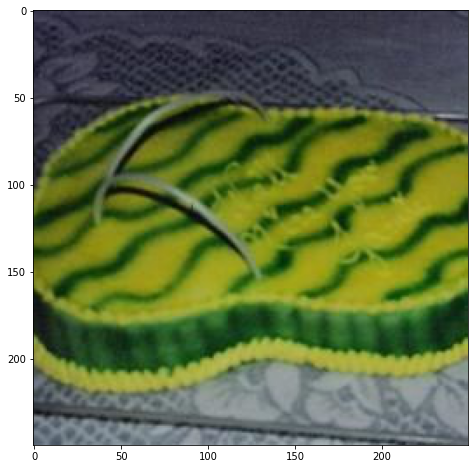

Creamy Whipped Frosting:

Real:
vanilla
sugar
butter
milk

Prediction:
flour
butter
egg yolk
vanilla
sugar
baking powder
salt

Epoch 43 train loss:	0.7924
Эпоха 44


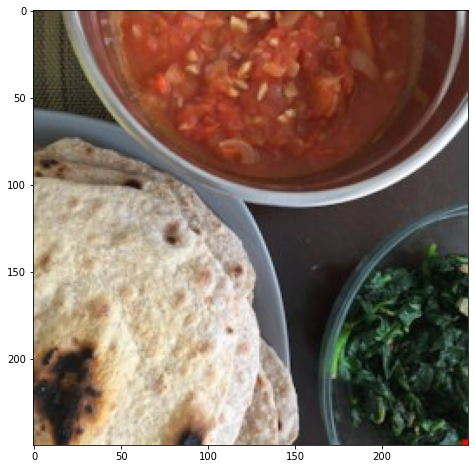

Quick Whole Wheat Chapati:

Real:
water
flour
salt

Prediction:
tomato
onion
rice
oil
celery
chicken
sausage
bell pepper


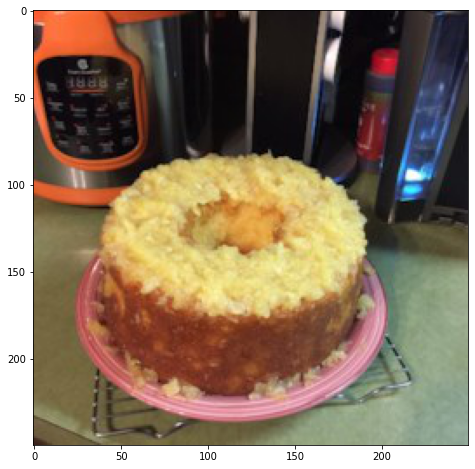

Pineapple Pound Cake:

Real:
flour
butter
milk
sugar
vanilla
baking powder
pineapple
egg

Prediction:
water
vegetables
pudding mix
butter
cake mix
sugar
walnut
egg

Epoch 44 train loss:	0.7892
Эпоха 45


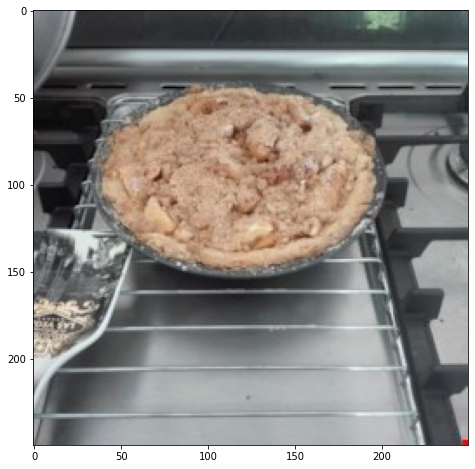

Easy Pie Crust:

Real:
flour
vegetables
milk
sugar
salt

Prediction:
black pepper
butter
cheese
milk
bread
chicken


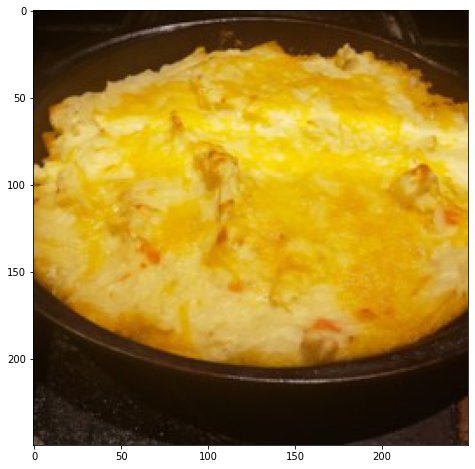

Shepherd's Pie VI:

Real:
flour
beef
vegetables
butter
cheddar
carrot
potato
onion
ketchup
salt

Prediction:
black pepper
cheddar
potato
milk
margarine

Epoch 45 train loss:	0.7851
Эпоха 46


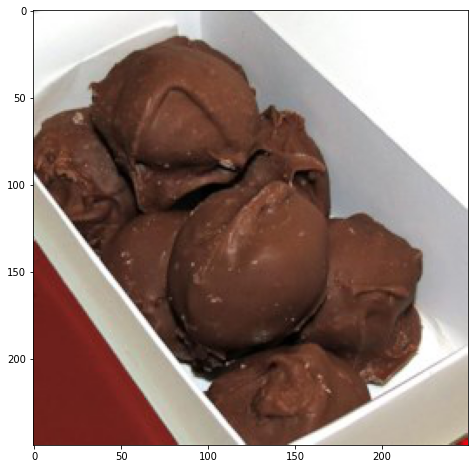

Baileys® Balls:

Real:
chocolate
almond
alcohol
pecan
butter
vanilla
sugar
sour cream
cocoa

Prediction:
chocolate
flour
butter
vanilla
sugar
milk


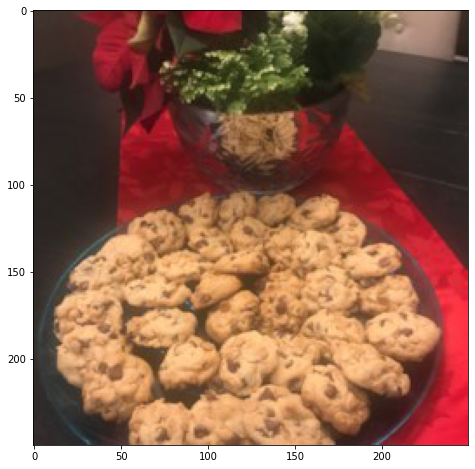

Double Peanut Butter & Milk Chocolate Chip Cookies:

Real:
peanut butter
flour
baking soda
butter
vanilla
milk
sugar
salt
egg

Prediction:
flour
butter
vanilla
sugar
walnut
salt

Epoch 46 train loss:	0.7816
Эпоха 47


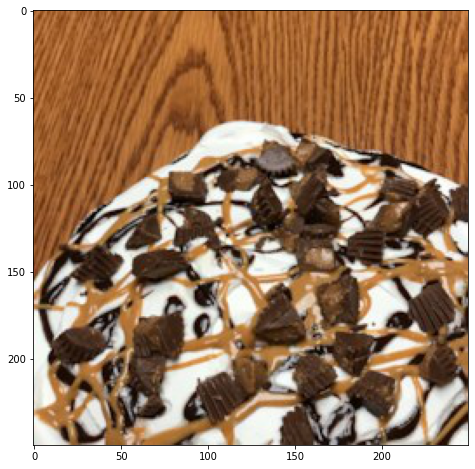

Decadent Peanut Butter Pie:

Real:
chocolate
peanut butter
sugar
cream cheese
ice cream

Prediction:
chocolate
peanut butter
sugar
cream cheese
ice cream


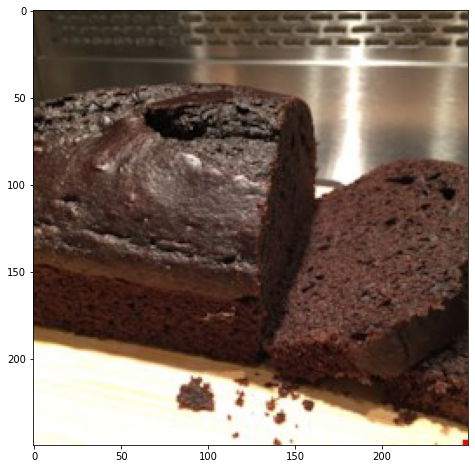

Sourdough Chocolate Cake:

Real:
water
flour
baking soda
vanilla
sugar
baking powder
salt
egg
cocoa

Prediction:
chocolate
flour
butter
vanilla
sugar
salt
egg

Epoch 47 train loss:	0.7777
Эпоха 48


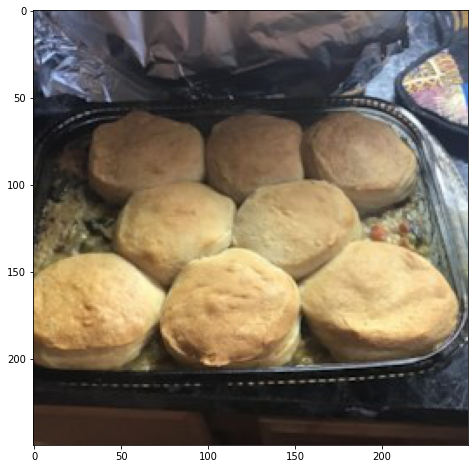

Chicken and Dumplings Casserole:

Real:
black pepper
flour
thyme
butter
carrot
pea
milk
onion
basil
poultry
celery
garlic
chicken
dough

Prediction:
flour
baking soda
butter
sugar
buttermilk
baking powder
salt


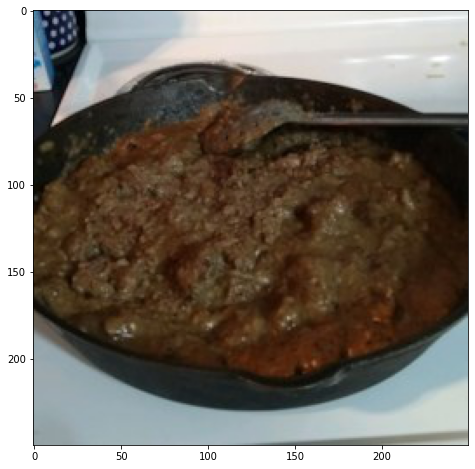

My Country Style Steak:

Real:
water
flour
vegetables
onion
salt
garlic

Prediction:
black pepper
pepper
beef
vegetables
butter
sauce

Epoch 48 train loss:	0.7733
Эпоха 49


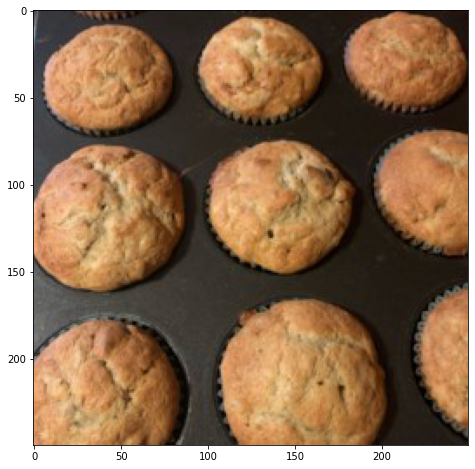

Oatmeal Craisin Cookies:

Real:
flour
baking soda
butter
raisin
vanilla
sugar
baking powder
salt
cranberry
egg

Prediction:
flour
vegetables
baking soda
apple
vanilla
sugar
walnut
cinnamon
salt
egg


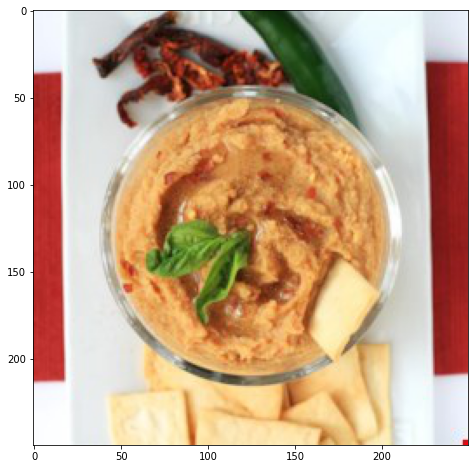

Spicy Hummus:

Real:
tomato
chili pepper
ground cumin
garlic
bean

Prediction:
black pepper
pepper
flour
vegetables
ground cumin
sauce
mayonnaise
lime
cilantro
salt
honey
egg

Epoch 49 train loss:	0.7706
Эпоха 50


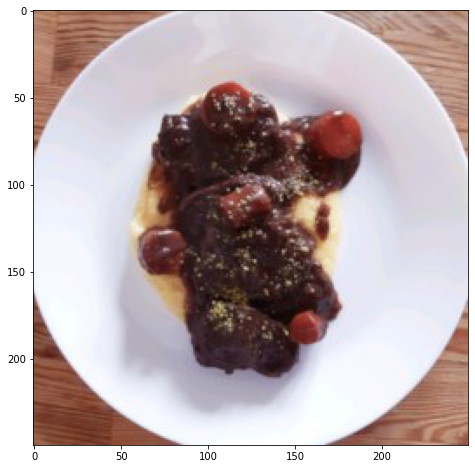

Beef Bourguignon Without the Burgundy:

Real:
black pepper
flour
beef
vegetables
thyme
butter
carrot
wine
onion
celery

Prediction:
black pepper
pepper
beef
sauce
garlic powder
paprika
sugar
salt


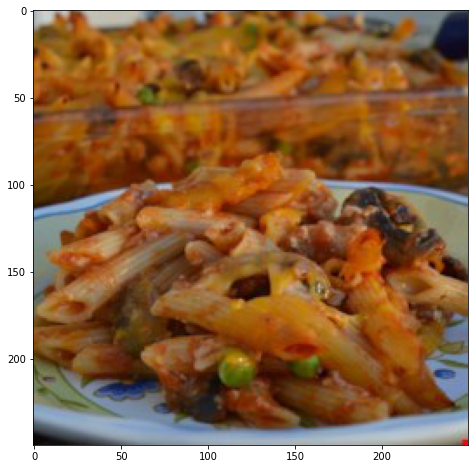

Stephanie's Best Casserole:

Real:
pasta
cheddar
olive
spaghetti
salt
chicken
mozzarella
broccoli

Prediction:
pasta
tomato
black pepper
parmesan
onion
olive
cloves garlic
sugar
cherry tomato
whipped cream
basil
mozzarella

Epoch 50 train loss:	0.7668


In [77]:
encoder.train()
decoder.train()

train(encoder, decoder, criterion, optimizer, num_epochs=25, epoch_losses=epoch_losses,
      log_step=250, start_epoch=26)

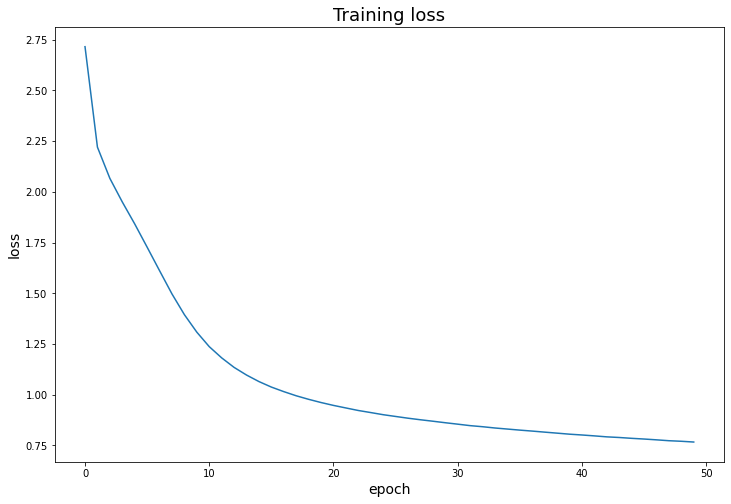

In [78]:
import matplotlib.pyplot as plt
plt.figure(figsize=(12, 8))
plt.plot(epoch_losses['train_nll'])
plt.title('Training loss', fontsize=18)
plt.ylabel('loss', fontsize=14)
plt.xlabel('epoch', fontsize=14)
plt.show()

In [184]:
encoder = Encoder(models.resnet101(pretrained=True), embed_size=embed_size, 
                  finetune=False).to(device)

In [185]:
encoder.load_state_dict(torch.load(f'/content/drive/My Drive/Dish-id/weights/enc_50_epoch.pth'))
decoder.load_state_dict(torch.load(f'/content/drive/My Drive/Dish-id/weights/dec_50_epoch.pth'))

<All keys matched successfully>

In [212]:
batch_size = 256
train_loader = torch.utils.data.DataLoader(train_data, batch_size=batch_size,
                                          num_workers=4, collate_fn=pad_collate, shuffle=True)

num_finetune = 2
encoder.finetune_active(True, num_finetune)

finetune_params = []
for layer in list(encoder.resnet.children())[-num_finetune:]:
  finetune_params.extend(layer.parameters())

optimizer = optim.Adadelta(params=list(decoder.parameters()) + finetune_params + list(encoder.linear.parameters()))

In [ ]:
encoder.train()
decoder.train()

train(encoder, decoder, criterion, optimizer, num_epochs=10, epoch_losses=epoch_losses,
      log_step=250, start_epoch=51)

In [ ]:
batch_size = 256
train_loader = torch.utils.data.DataLoader(train_data, batch_size=batch_size,
                                          num_workers=4, collate_fn=pad_collate, shuffle=True)

num_finetune = 2
encoder.finetune_active(True, num_finetune)

finetune_params = []
for layer in list(encoder.resnet.children())[-num_finetune:]:
  finetune_params.extend(layer.parameters())

optimizer = optim.Adadelta(params=list(decoder.parameters()) + finetune_params + list(encoder.linear.parameters()))

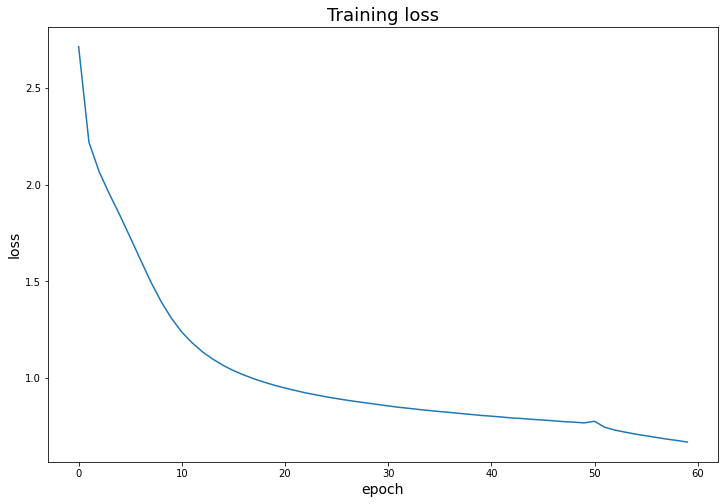

In [215]:
import matplotlib.pyplot as plt
plt.figure(figsize=(12, 8))
plt.plot(epoch_losses['train_nll'])
plt.title('Training loss', fontsize=18)
plt.ylabel('loss', fontsize=14)
plt.xlabel('epoch', fontsize=14)
plt.show()

In [258]:
encoder.load_state_dict(torch.load(f'/content/drive/My Drive/Dish-id/weights/enc_0_epoch.pth'))
encoder.finetune = False
decoder.load_state_dict(torch.load(f'/content/drive/My Drive/Dish-id/weights/dec_0_epoch.pth'))

<All keys matched successfully>

In [ ]:
encoder.eval()
decoder.eval()

for i in range(10):
  predict_val_image()